In [20]:
import matplotlib.pyplot as plt
import numpy as np
import cv2


%matplotlib inline


In [21]:
class_names = ['20 pesos', '50 pesos', '100 pesos', '500 pesos', '1000 pesos']

In [22]:
from glob import glob
# from keras import preprocessing
# import keras.utils as image
# import tensorflow.keras.preprocessing
from keras.utils import load_img, img_to_array, array_to_img

width = 96
height = 96

images_type_1 = [ ]
images_type_2 = [ ]
images_type_3 = [ ]
images_type_4 = [ ]
images_type_5 = [ ]

for image_path in glob('img_1/*.*'):
    image = load_img(image_path, target_size = (width, height))
    x = img_to_array(image)

    images_type_1.append(x)
    
for image_path in glob('img_2/*.*'):
    image = load_img(image_path, target_size = (width, height))
    x = img_to_array(image)

    images_type_2.append(x)
    
for image_path in glob('img_3/*.*'):
    image = load_img(image_path, target_size = (width, height))
    x = img_to_array(image)

    images_type_3.append(x)
    
for image_path in glob('img_4/*.*'):
    image = load_img(image_path, target_size = (width, height))
    x = img_to_array(image)

    images_type_4.append(x)

for image_path in glob('img_5/*.*'):
    image = load_img(image_path, target_size = (width, height))
    x = img_to_array(image)

    images_type_5.append(x)

plt.figure(figsize=(12, 8))


<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

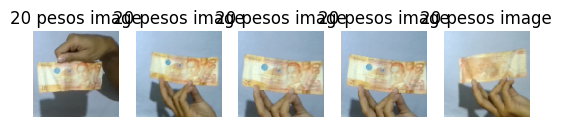

In [23]:

for i, x in enumerate(images_type_1[:5]):
    plt.subplot(1, 5, i+1)
    image = array_to_img(x)
    plt.imshow(image)

    plt.axis('off')
    plt.title('{} image'.format(class_names[0]))

plt.show()


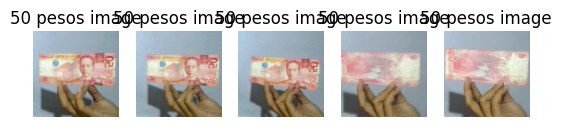

In [24]:

for i, x in enumerate(images_type_2[:5]):
    plt.subplot(1, 5, i+1)
    image = array_to_img(x)
    plt.imshow(image)

    plt.axis('off')
    plt.title('{} image'.format(class_names[1]))

plt.show()


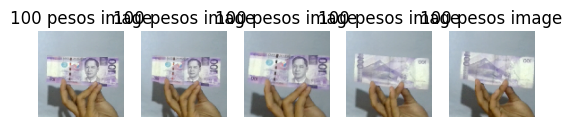

In [25]:

for i, x in enumerate(images_type_3[:5]):
    plt.subplot(1, 5, i+1)
    image = array_to_img(x)
    plt.imshow(image)

    plt.axis('off')
    plt.title('{} image'.format(class_names[2]))

plt.show()


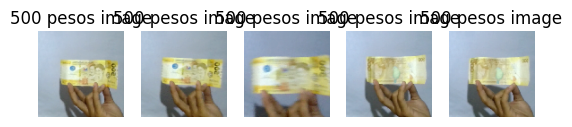

In [26]:

for i, x in enumerate(images_type_4[:5]):
    plt.subplot(1, 5, i+1)
    image = array_to_img(x)
    plt.imshow(image)

    plt.axis('off')
    plt.title('{} image'.format(class_names[3]))

plt.show()


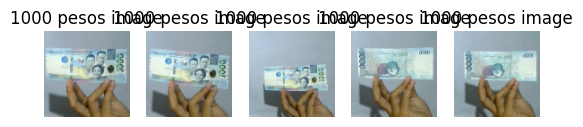

In [27]:

for i, x in enumerate(images_type_5[:5]):
    plt.subplot(1, 5, i+1)
    image = array_to_img(x)
    plt.imshow(image)

    plt.axis('off')
    plt.title('{} image'.format(class_names[4]))

plt.show()


In [28]:

#prepare image to tensor

X_type_1 = np.array(images_type_1)
X_type_2 = np.array(images_type_2)
X_type_3 = np.array(images_type_3)
X_type_4 = np.array(images_type_4)
X_type_5 = np.array(images_type_5)

#check the shape using .shape() check the images count

print (X_type_1.shape)
print (X_type_2.shape)
print (X_type_3.shape)
print (X_type_4.shape)
print (X_type_5.shape)


# (13, 96, 96, 3)
# (23, 96, 96, 3)
# (14, 96, 96, 3)
# (22, 96, 96, 3)

# X_type_2



(21, 96, 96, 3)
(21, 96, 96, 3)
(21, 96, 96, 3)
(21, 96, 96, 3)
(15, 96, 96, 3)


In [29]:
X = np.concatenate((X_type_1, X_type_2), axis= 0)

if len(X_type_3):
    X = np.concatenate((X, X_type_3), axis= 0)
if len (X_type_4):
    X = np.concatenate((X, X_type_4), axis= 0)
if len (X_type_5):
    X = np.concatenate((X, X_type_5), axis= 0)

X = X / 250.0

X.shape



(99, 96, 96, 3)

In [30]:
from keras.utils import to_categorical

y_type_1 = [0 for item in enumerate(X_type_1)]
y_type_2 = [1 for item in enumerate(X_type_2)]
y_type_3 = [2 for item in enumerate(X_type_3)]
y_type_4 = [3 for item in enumerate(X_type_4)]
y_type_5 = [4 for item in enumerate(X_type_5)]

y = np.concatenate((y_type_1, y_type_2), axis= 0)

if len(y_type_3):
    y = np.concatenate((y, y_type_3), axis= 0)
if len(y_type_4):
    y = np.concatenate((y, y_type_4), axis= 0)
if len(y_type_5):
    y = np.concatenate((y, y_type_5), axis= 0)

y = to_categorical(y, num_classes=len(class_names))

y.shape

(99, 5)

In [31]:
#CNN config

from keras.models import Sequential
from keras.layers.core import Activation, Dropout, Flatten, Dense
from keras.layers.convolutional import Convolution2D, MaxPooling2D
from keras.optimizers import Adam


#default parameters

#situational - values, you may not adjust here

conv_1 = 16
conv_1_drop = 0.2
conv_2 = 32
conv_2_drop = 0.2
dense_1_n = 1024
dense_1_drop = 0.2
dense_2_n = 512
dense_2_drop = 0.2

#values you can adjust
lr = 0.001
epochs = 10
batch_size = 10
color_channels = 3


def build_model(conv_1_drop = conv_1_drop, conv_2_drop =conv_2_drop,
                dense_1_n = dense_1_n, dense_1_drop = dense_1_drop,
                dense_2_n = dense_2_n, dense_2_drop = dense_2_drop, lr = lr):
    
    model = Sequential()

    model.add(Convolution2D(conv_1, (3,3),
                            input_shape = (width, height,color_channels),
                            activation='relu'))
    
    model.add(MaxPooling2D(pool_size = (2,2)))
    model.add(Dropout(conv_1_drop))
    
    #---
    model.add(Convolution2D(conv_2, (3,3), activation='relu'))
    model.add(MaxPooling2D(pool_size = (2,2)))
    model.add(Dropout(conv_2_drop)) #Changed 

    #---
    model.add(Flatten())

    #---
    model.add(Dense(dense_1_n, activation='relu'))
    model.add(Dropout(dense_1_drop))

    #---
    model.add(Dense(dense_2_n, activation= 'relu'))
    model.add(Dropout(dense_2_drop))

    #---
    model.add(Dense(len(class_names), activation= 'softmax'))

    model.compile(loss = 'categorical_crossentropy',
                optimizer= Adam(clipvalue = 0.5),
                metrics=['accuracy'])
    
    return model

#model parameter

model = build_model()
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 94, 94, 16)        448       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 47, 47, 16)       0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 47, 47, 16)        0         
                                                                 
 conv2d_3 (Conv2D)           (None, 45, 45, 32)        4640      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 22, 22, 32)       0         
 2D)                                                             
                                                                 
 dropout_5 (Dropout)         (None, 22, 22, 32)       

In [32]:
#do not run yet

history = model.fit(X, y, validation_split = 0.10, epochs = 10, batch_size = 5)

print (history)


Epoch 1/10
18/18 [==============================] - 11s 492ms/step - loss: 2.7176 - accuracy: 0.2135 - val_loss: 2.0321 - val_accuracy: 0.0000e+00
Epoch 2/10
18/18 [==============================] - 8s 444ms/step - loss: 1.5266 - accuracy: 0.3483 - val_loss: 1.6978 - val_accuracy: 0.0000e+00
Epoch 3/10
18/18 [==============================] - 8s 439ms/step - loss: 1.4750 - accuracy: 0.3820 - val_loss: 1.7356 - val_accuracy: 0.0000e+00
Epoch 4/10
18/18 [==============================] - 8s 427ms/step - loss: 1.2129 - accuracy: 0.5843 - val_loss: 1.7584 - val_accuracy: 0.0000e+00
Epoch 5/10
18/18 [==============================] - 8s 436ms/step - loss: 0.7798 - accuracy: 0.7079 - val_loss: 1.4399 - val_accuracy: 0.0000e+00
Epoch 6/10
18/18 [==============================] - 7s 402ms/step - loss: 0.4660 - accuracy: 0.8202 - val_loss: 1.1645 - val_accuracy: 0.2000
Epoch 7/10
18/18 [==============================] - 7s 410ms/step - loss: 0.2158 - accuracy: 0.9438 - val_loss: 1.5759 - val_ac

Accuracy: 90.91%


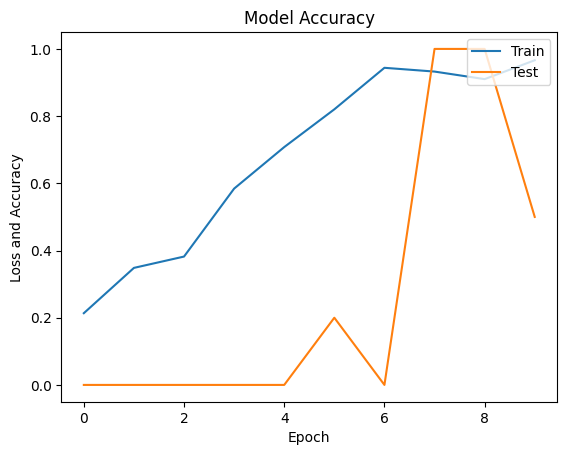

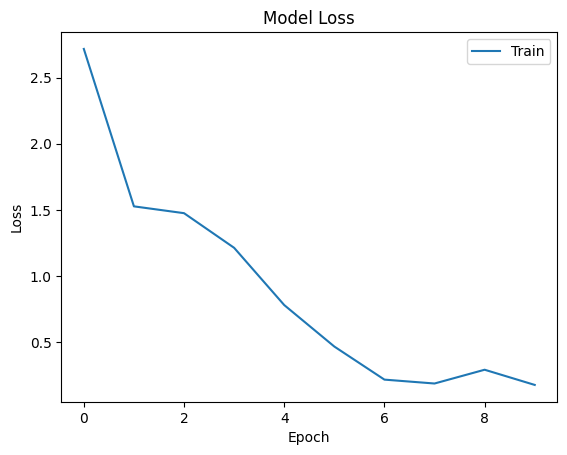

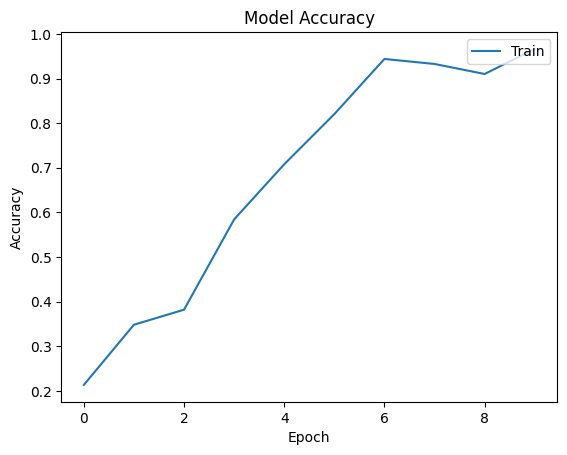

In [33]:
scores = model.evaluate(X, y, verbose=0)
print('Accuracy: %.2f%%' % (scores[1]*100))

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Loss and Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

plt.plot(history.history['loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

plt.plot(history.history['accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

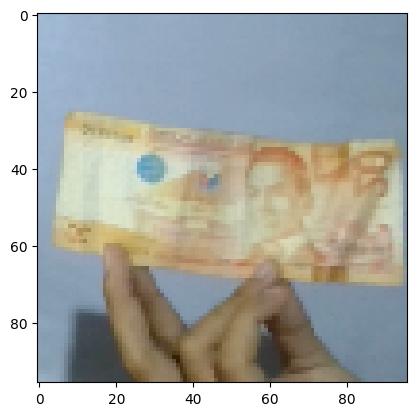

1/1 [==============================] - 0s 320ms/step
20 pesos


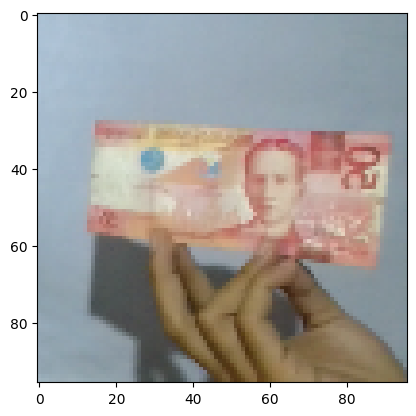

1/1 [==============================] - 0s 78ms/step
50 pesos


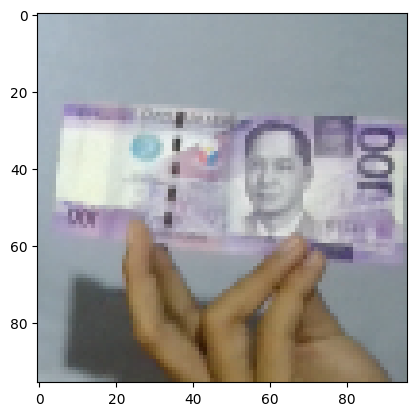

1/1 [==============================] - 0s 53ms/step
100 pesos


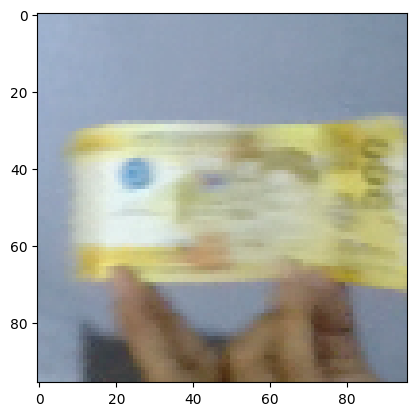

1/1 [==============================] - 0s 54ms/step
500 pesos


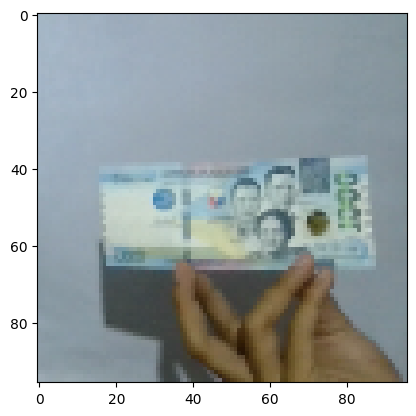

1/1 [==============================] - 0s 41ms/step
100 pesos


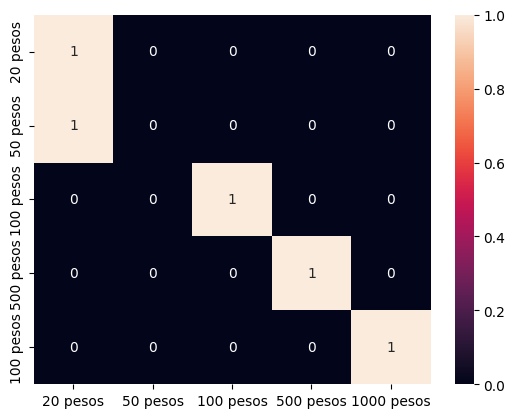

In [34]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plt_show(img):
    plt.imshow(img)
    plt.show()

# class_names = ['BAG', 'BALLPOINT', 'PAPER', 'PENCIL', 'WATER BOTTLE']

_50_bills = 'img_1/10.png'
_100_bills = 'img_2/10.png'
_200_bills= 'img_3/10.png'
_500_bills = 'img_4/10.png'
_1000_bills = 'img_5/10.png'

imgs = [_50_bills, _100_bills, _200_bills, _500_bills, _1000_bills]

classes = None
predicted_classes = [ ]

for i in range(len(imgs)):
    type_ = load_img(imgs[i], target_size=(width, height))
    plt.imshow(type_)
    plt.show()

    type_x = np.expand_dims(type_, axis=0)
    prediction = model.predict(type_x)
    index = np.argmax(prediction)
    print(class_names[index])
    classes = class_names[index]
    predicted_classes.append(class_names[index])

cm = confusion_matrix(class_names, predicted_classes)
f = sns.heatmap(cm, xticklabels=class_names, yticklabels=predicted_classes, annot=True)

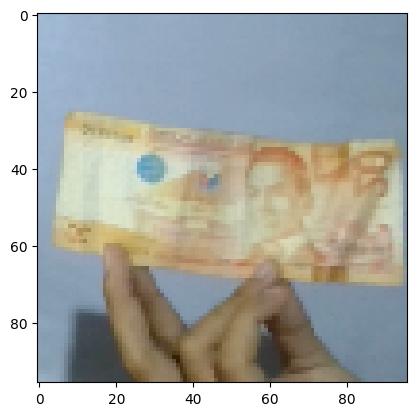

1/1 [==============================] - 0s 37ms/step
20 pesos


In [35]:
type_1 = load_img(imgs[0], target_size=(width, height)) 

plt.imshow(type_1)
plt.show()

type_1_x = np.expand_dims(type_1, axis=0)
prediction = model.predict(type_1_x)
index = np.argmax(prediction)

print(class_names[index])

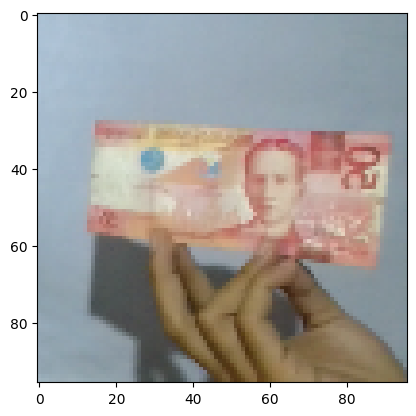

1/1 [==============================] - 0s 43ms/step
50 pesos


In [36]:
type_2 = load_img(imgs[1], target_size=(width, height)) #Need further checking

plt.imshow(type_2)
plt.show()

type_2_x = np.expand_dims(type_2, axis=0)
prediction = model.predict(type_2_x)                
index = np.argmax(prediction)

print(class_names[index])

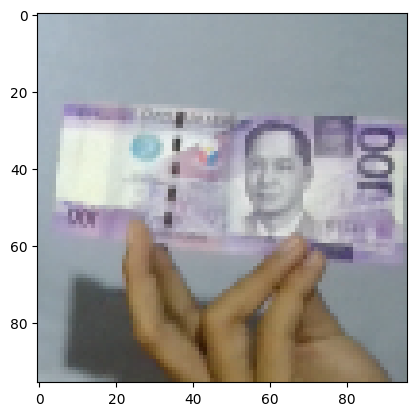

1/1 [==============================] - 0s 48ms/step
100 pesos


In [37]:
type_3 = load_img(imgs[2], target_size=(width, height)) #Need further checking

plt.imshow(type_3)
plt.show()

type_3_x = np.expand_dims(type_3, axis=0)
prediction = model.predict(type_3_x)

index = np.argmax(prediction)
print(class_names[index])

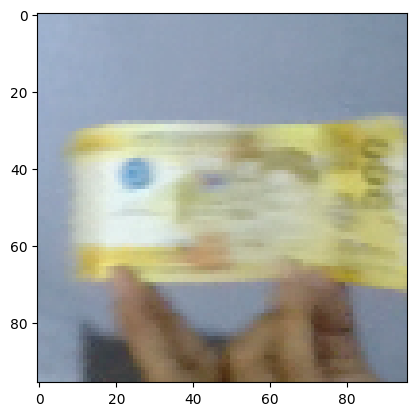

1/1 [==============================] - 0s 58ms/step
500 pesos


In [38]:
type_4 = load_img(imgs[3], target_size=(width, height)) #Need further checking

plt.imshow(type_4)
plt.show()

type_4_x = np.expand_dims(type_4, axis=0)
prediction = model.predict(type_4_x)

index = np.argmax(prediction)
print(class_names[index])

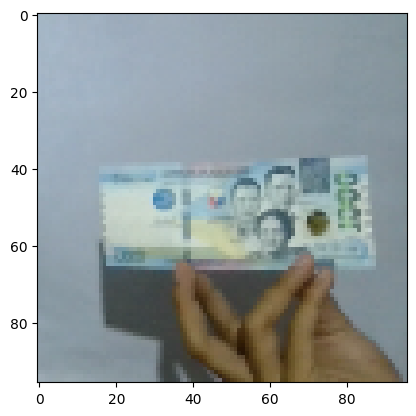

1/1 [==============================] - 0s 42ms/step
100 pesos


In [39]:
type_5 = load_img(imgs[4], target_size=(width, height)) #Need further checking

plt.imshow(type_5)
plt.show()

type_5_x = np.expand_dims(type_5, axis=0)
prediction = model.predict(type_5_x)

index = np.argmax(prediction)
print(class_names[index])

1/1 [==============================] - 0s 73ms/step


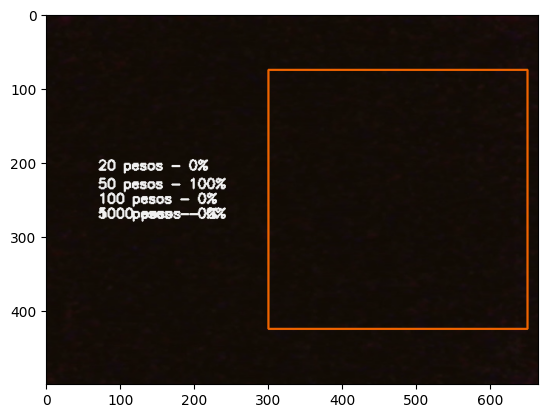

1/1 [==============================] - 0s 77ms/step


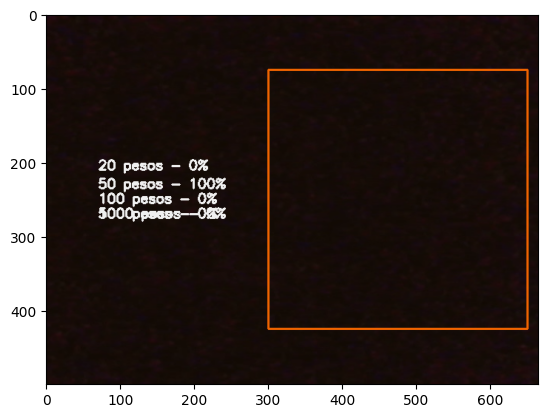

1/1 [==============================] - 0s 38ms/step


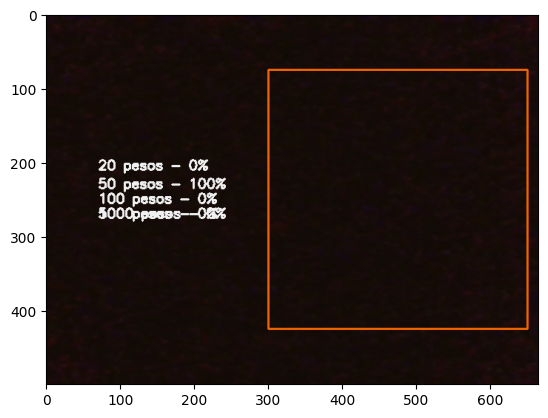

1/1 [==============================] - 0s 42ms/step


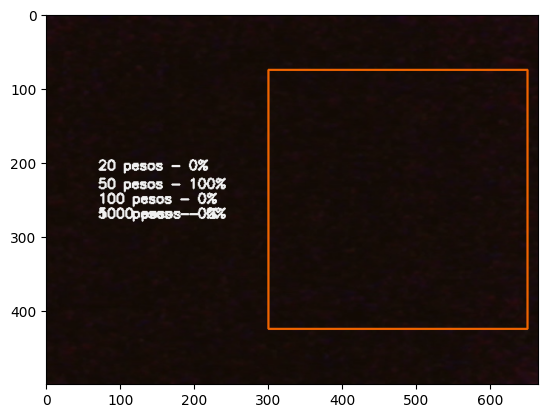

1/1 [==============================] - 0s 51ms/step


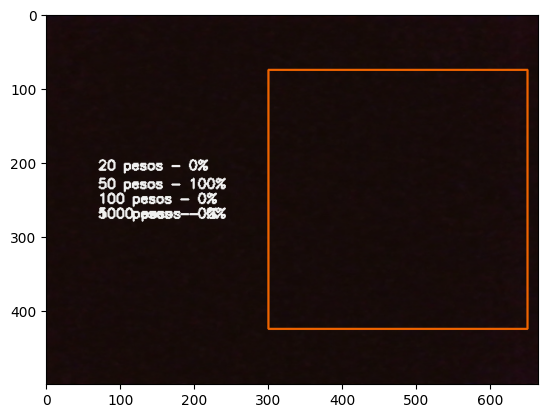

1/1 [==============================] - 0s 47ms/step


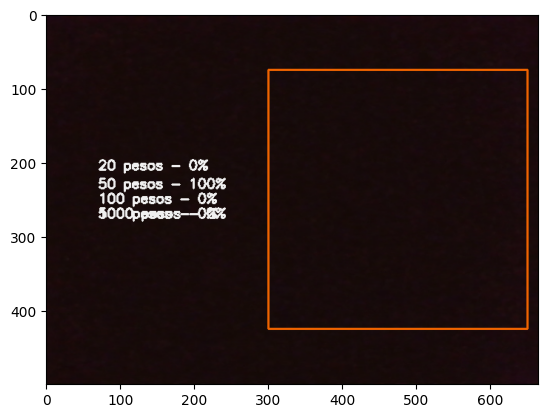

1/1 [==============================] - 0s 77ms/step


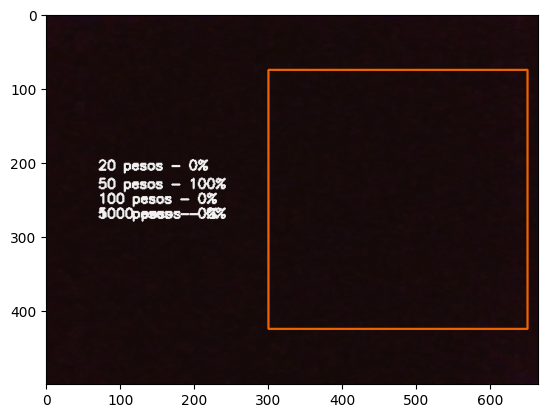

1/1 [==============================] - 0s 53ms/step


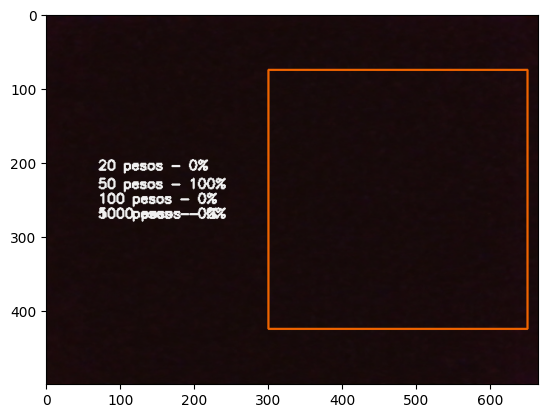

1/1 [==============================] - 0s 54ms/step


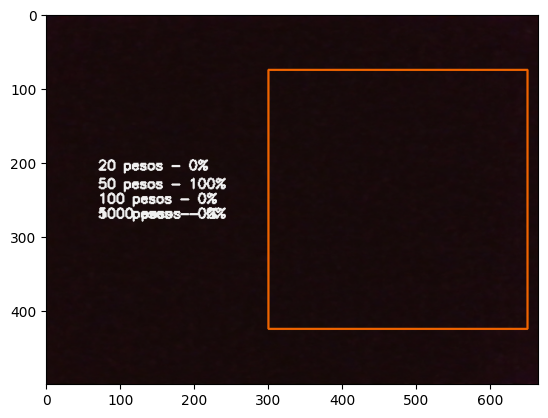

1/1 [==============================] - 0s 62ms/step


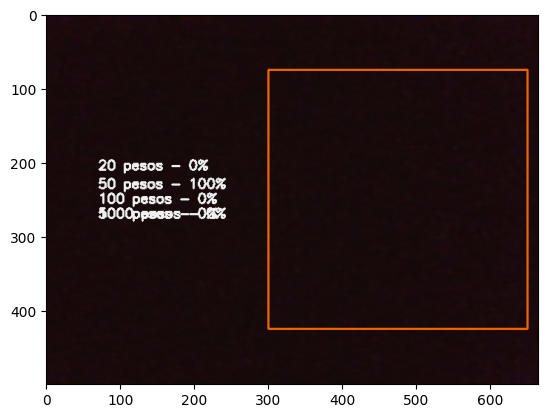

1/1 [==============================] - 0s 69ms/step


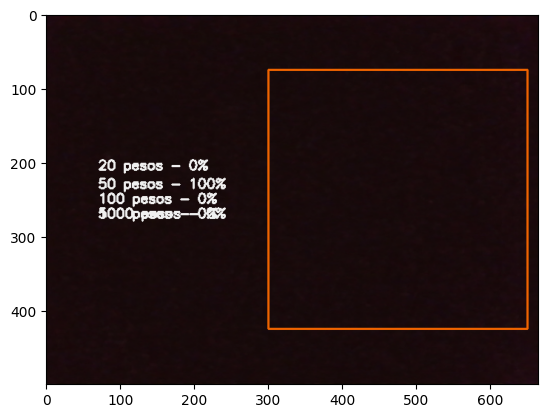

1/1 [==============================] - 0s 45ms/step


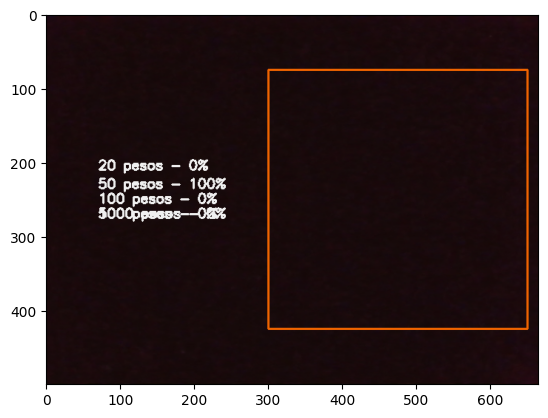

1/1 [==============================] - 0s 136ms/step


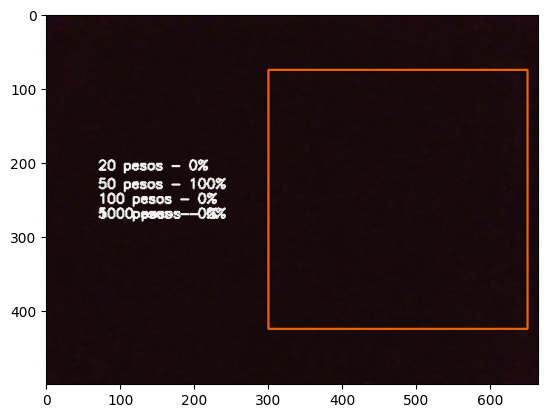

1/1 [==============================] - 0s 88ms/step


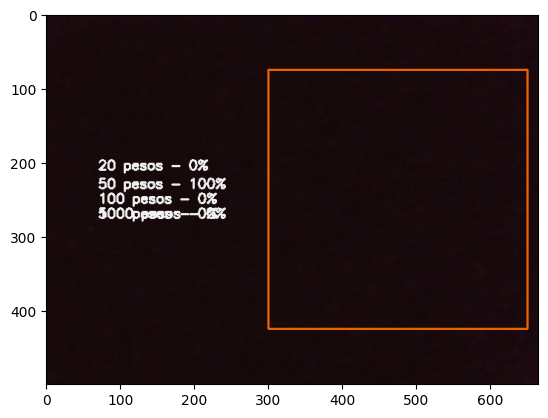

1/1 [==============================] - 0s 72ms/step


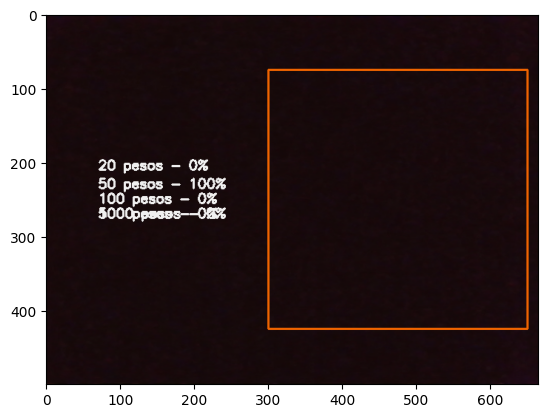

1/1 [==============================] - 0s 63ms/step


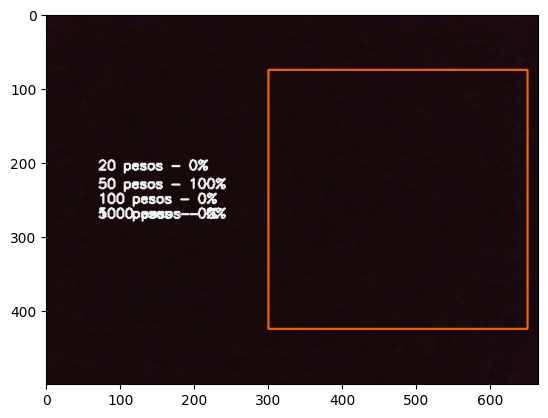

1/1 [==============================] - 0s 113ms/step


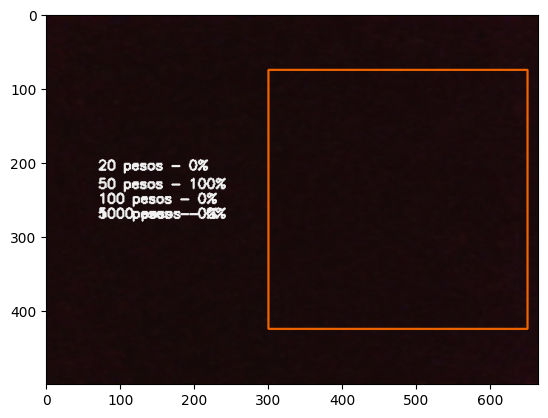

1/1 [==============================] - 0s 38ms/step


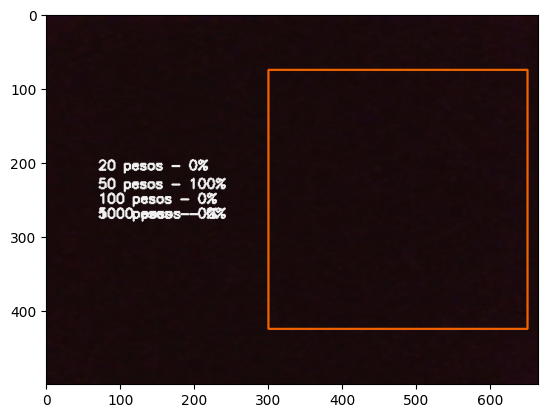

1/1 [==============================] - 0s 66ms/step


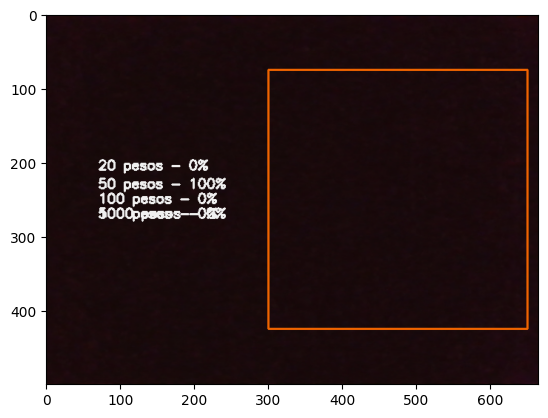

1/1 [==============================] - 0s 137ms/step


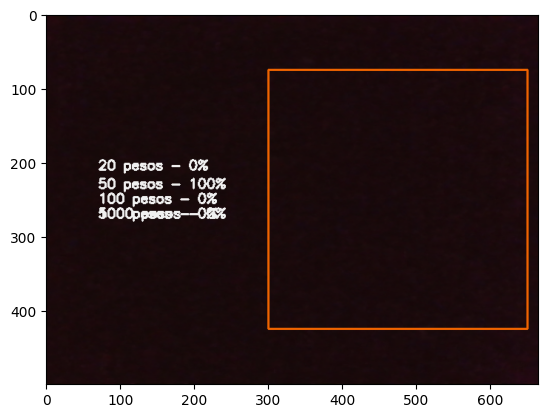

1/1 [==============================] - 0s 47ms/step


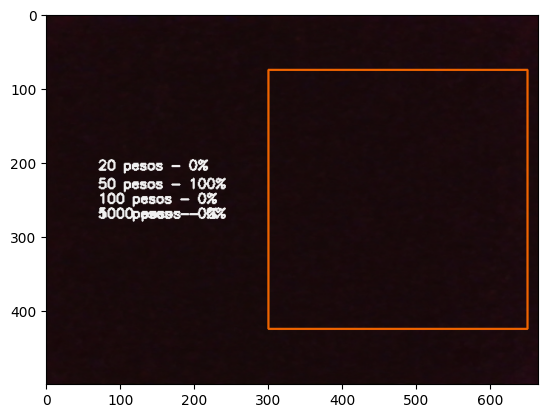

1/1 [==============================] - 0s 56ms/step


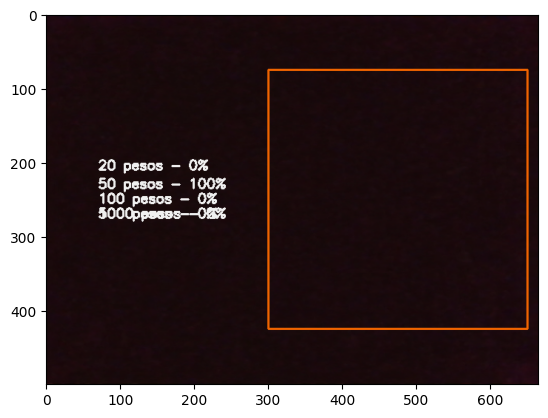

1/1 [==============================] - 0s 142ms/step


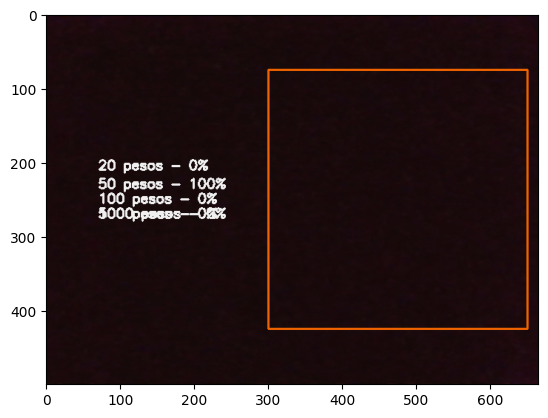

1/1 [==============================] - 0s 43ms/step


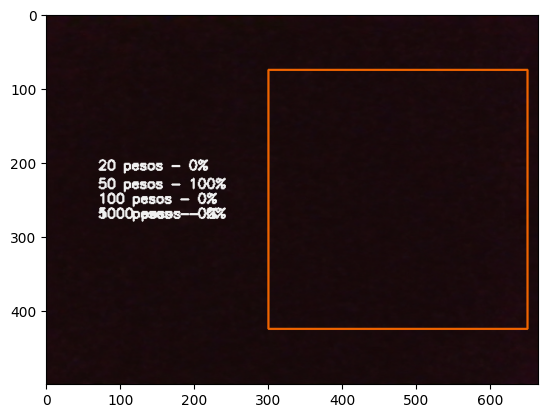

1/1 [==============================] - 0s 68ms/step


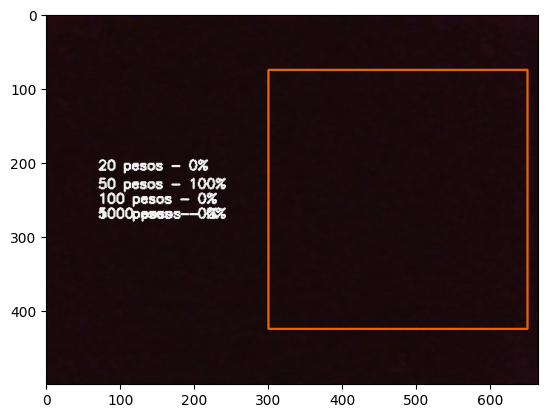

1/1 [==============================] - 0s 43ms/step


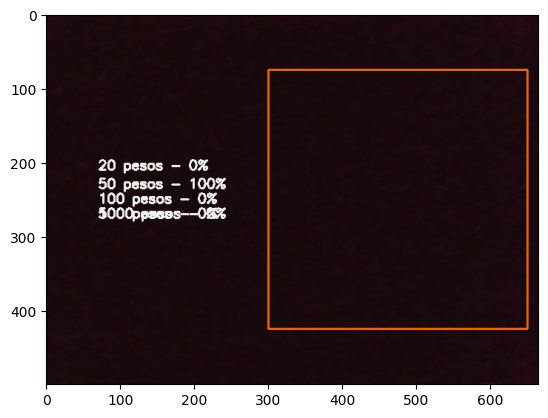

1/1 [==============================] - 0s 46ms/step


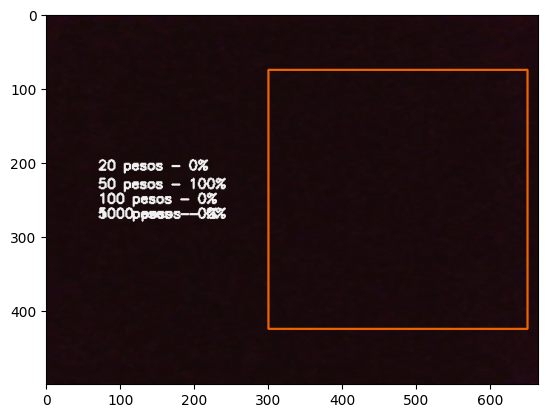

1/1 [==============================] - 0s 53ms/step


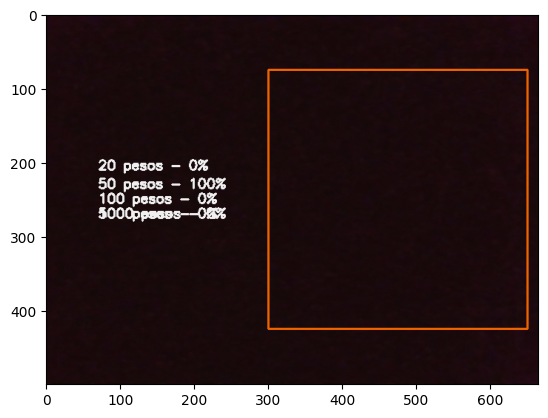

1/1 [==============================] - 0s 85ms/step


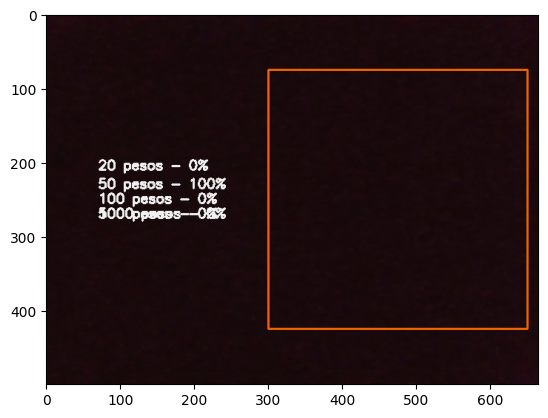

1/1 [==============================] - 0s 69ms/step


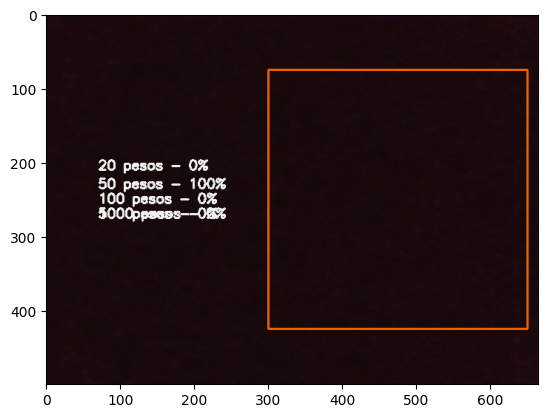

1/1 [==============================] - 0s 112ms/step


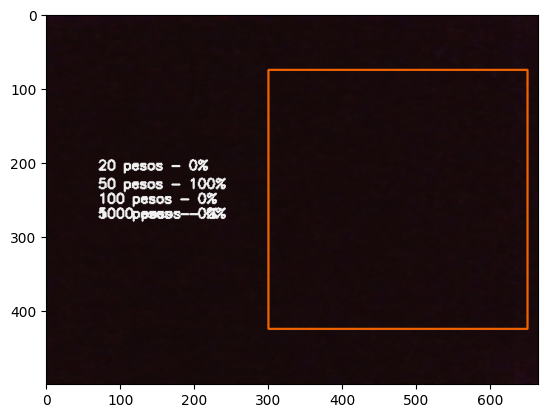

1/1 [==============================] - 0s 57ms/step


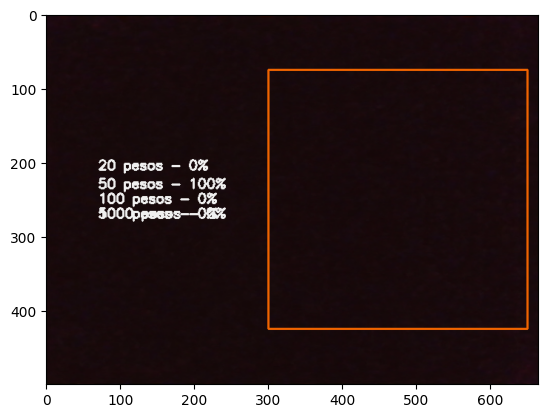

1/1 [==============================] - 0s 103ms/step


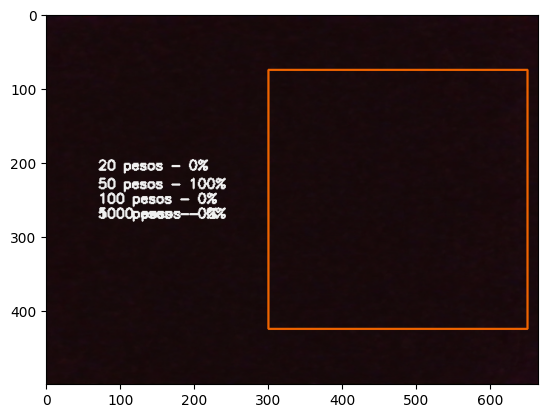

1/1 [==============================] - 0s 94ms/step


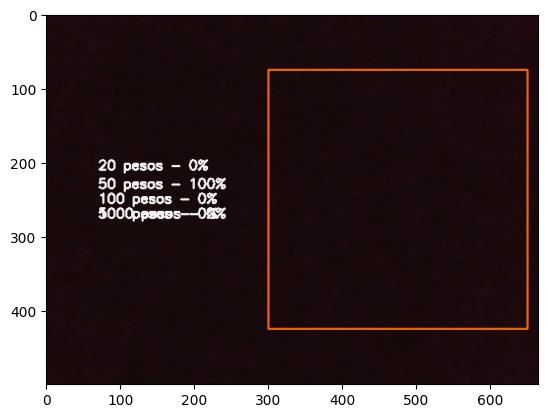

1/1 [==============================] - 0s 93ms/step


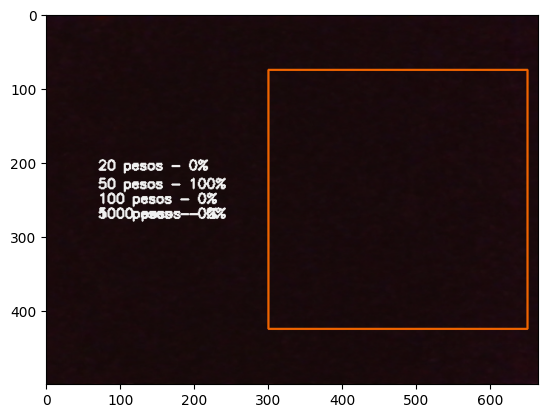

1/1 [==============================] - 0s 57ms/step


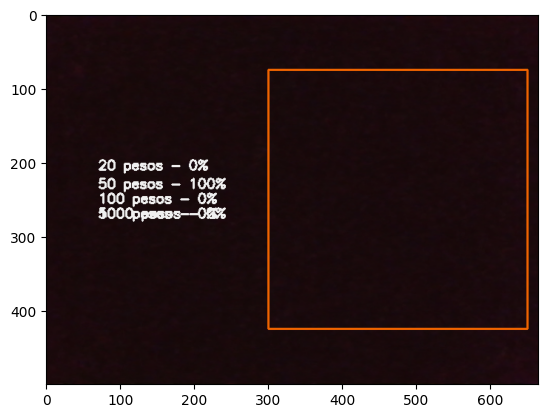

1/1 [==============================] - 0s 65ms/step


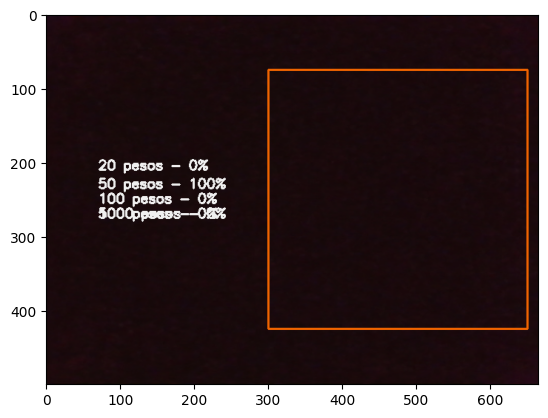

1/1 [==============================] - 0s 54ms/step


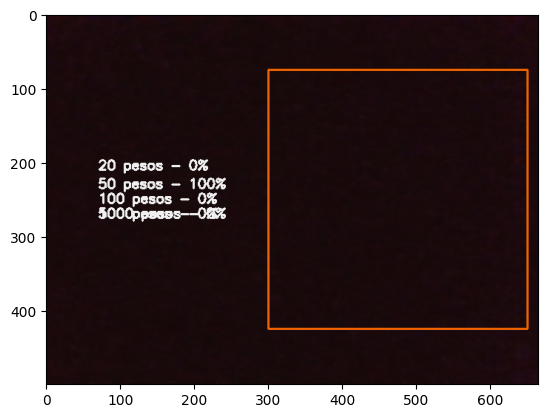

1/1 [==============================] - 0s 99ms/step


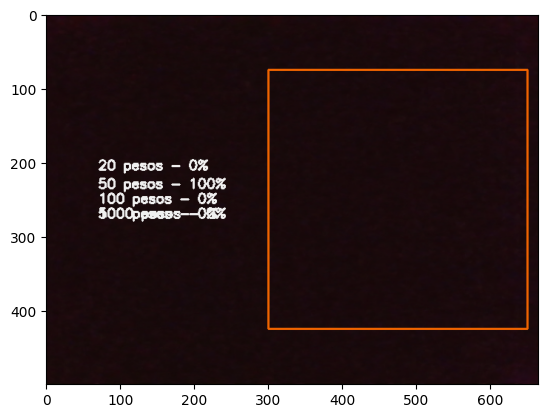

1/1 [==============================] - 0s 106ms/step


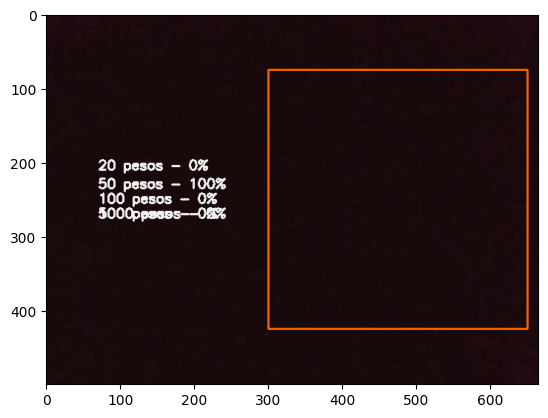

1/1 [==============================] - 0s 64ms/step


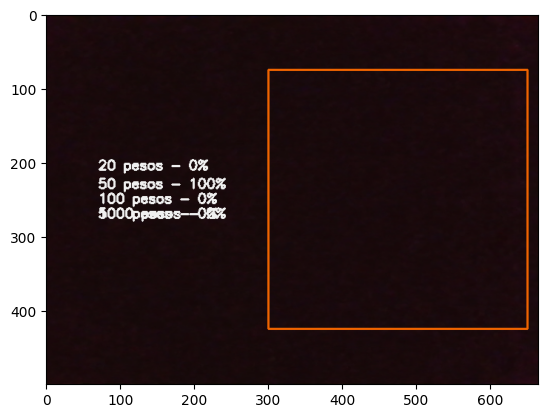

1/1 [==============================] - 0s 93ms/step


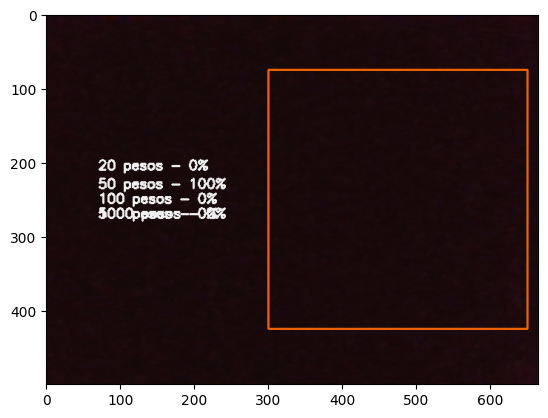

1/1 [==============================] - 0s 83ms/step


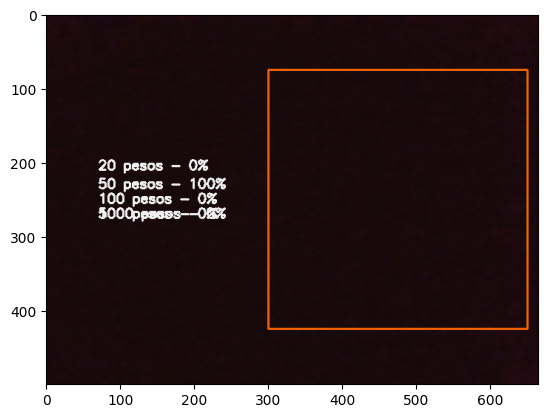

1/1 [==============================] - 0s 125ms/step


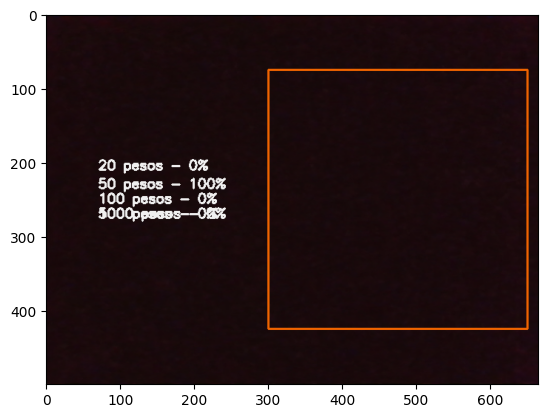

1/1 [==============================] - 0s 137ms/step


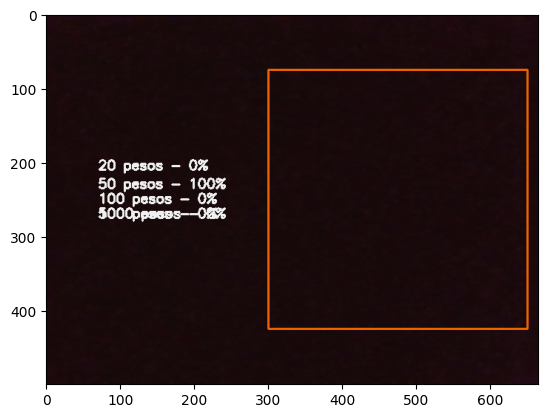

1/1 [==============================] - 0s 90ms/step


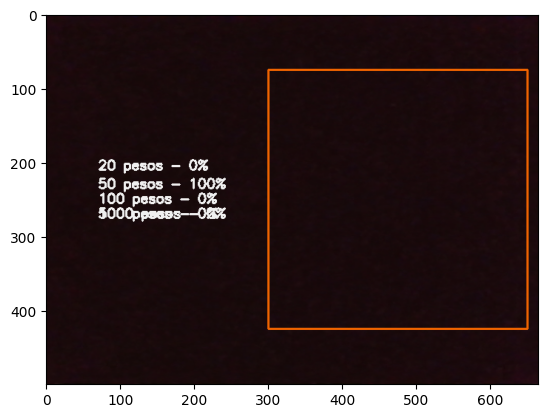

1/1 [==============================] - 0s 90ms/step


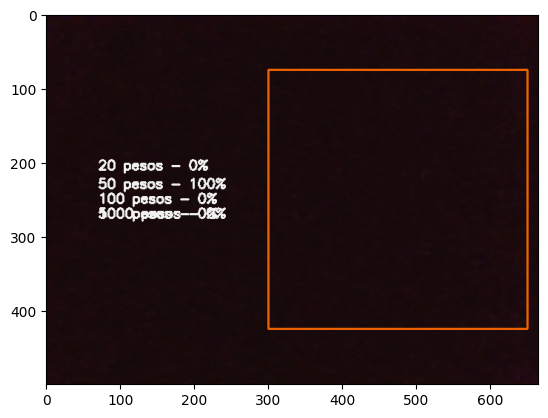

1/1 [==============================] - 0s 60ms/step


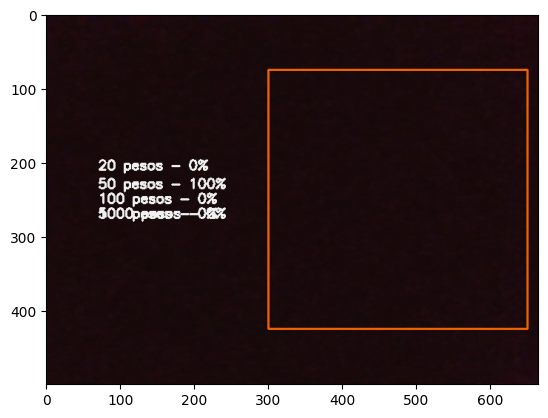

1/1 [==============================] - 0s 92ms/step


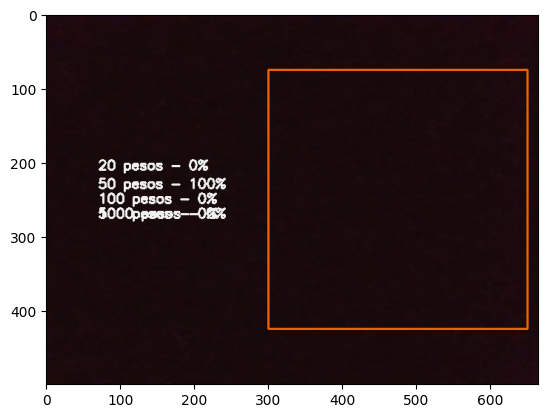

1/1 [==============================] - 0s 107ms/step


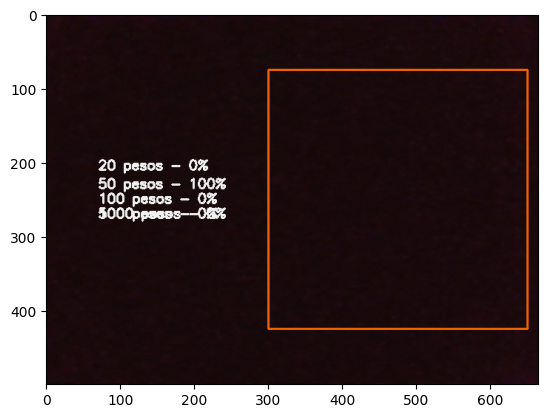

1/1 [==============================] - 0s 84ms/step


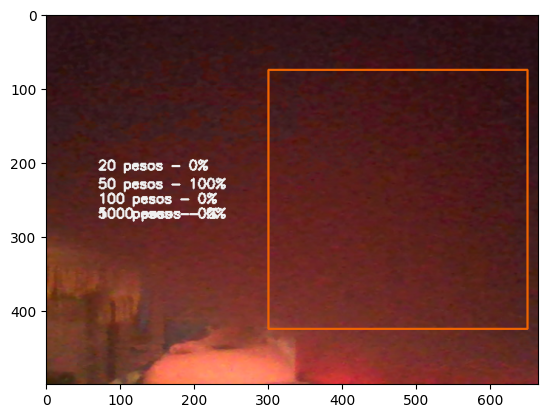

1/1 [==============================] - 0s 96ms/step


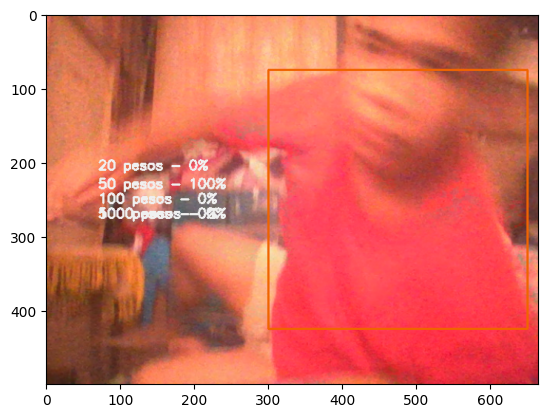

1/1 [==============================] - 0s 58ms/step


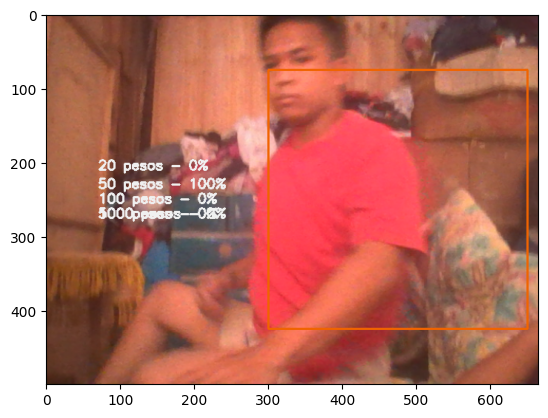

1/1 [==============================] - 0s 65ms/step


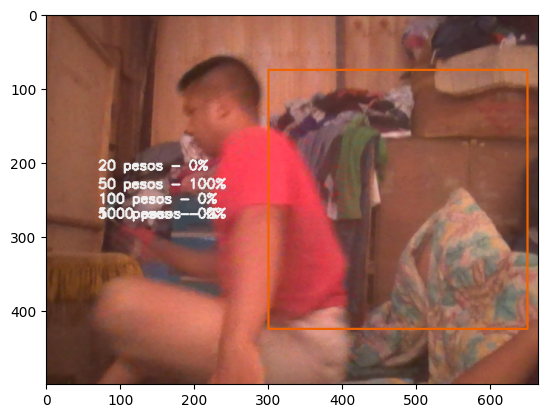

1/1 [==============================] - 0s 96ms/step


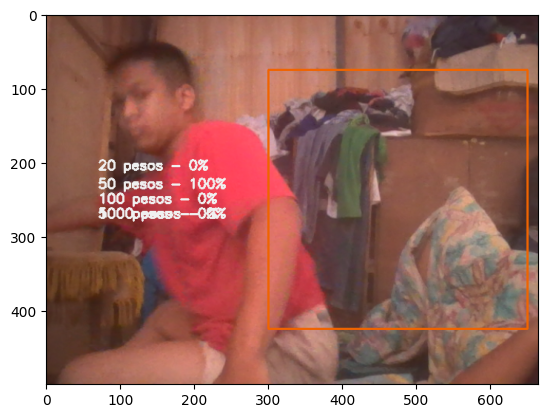

1/1 [==============================] - 0s 107ms/step


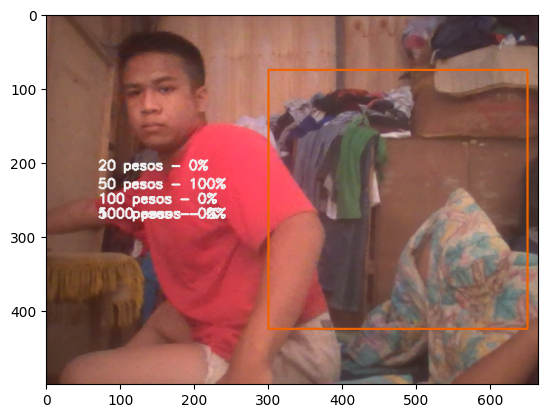

1/1 [==============================] - 0s 69ms/step


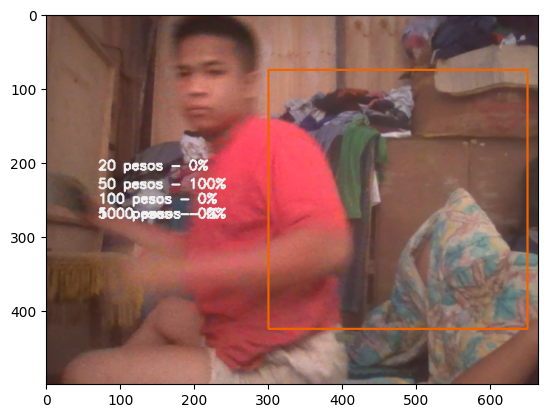

1/1 [==============================] - 0s 55ms/step


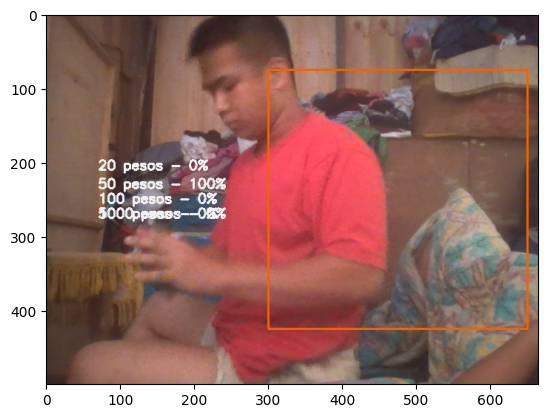

1/1 [==============================] - 0s 69ms/step


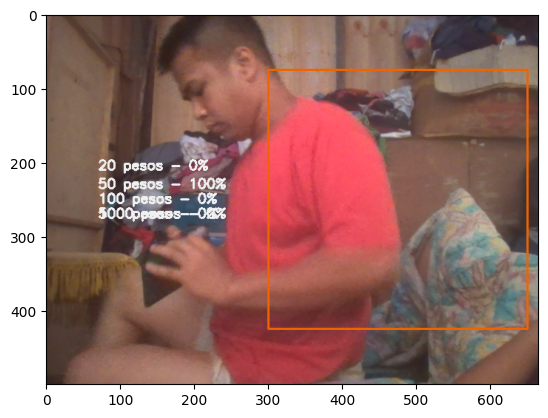

1/1 [==============================] - 0s 46ms/step


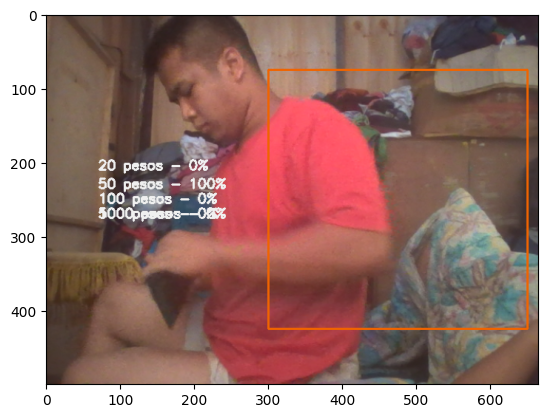

1/1 [==============================] - 0s 84ms/step


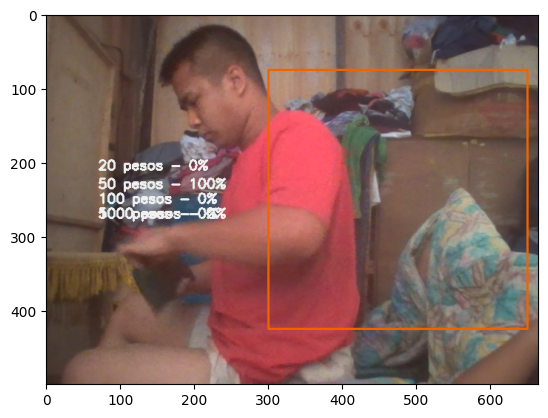

1/1 [==============================] - 0s 93ms/step


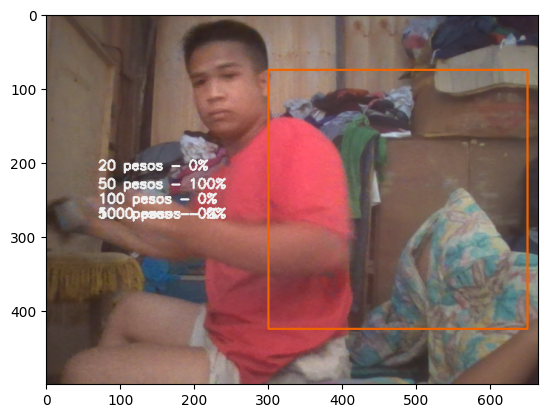

1/1 [==============================] - 0s 101ms/step


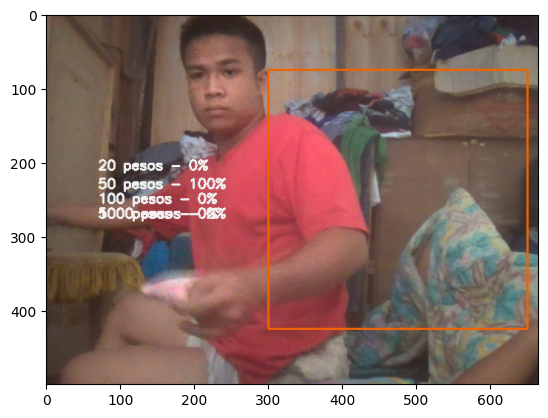

1/1 [==============================] - 0s 101ms/step


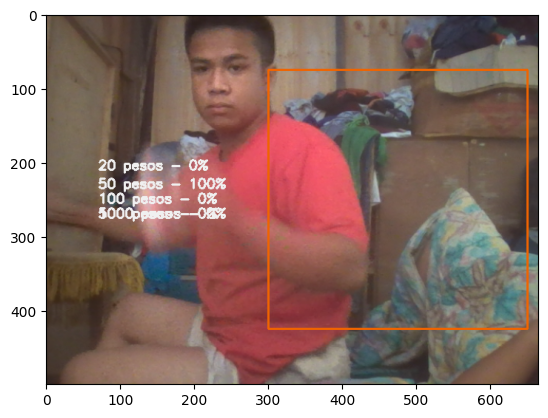

1/1 [==============================] - 0s 62ms/step


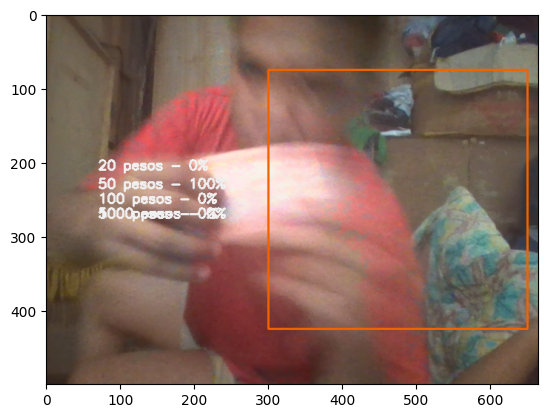

1/1 [==============================] - 0s 52ms/step


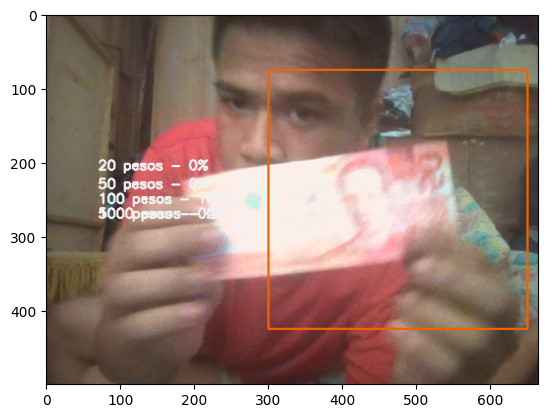

1/1 [==============================] - 0s 71ms/step


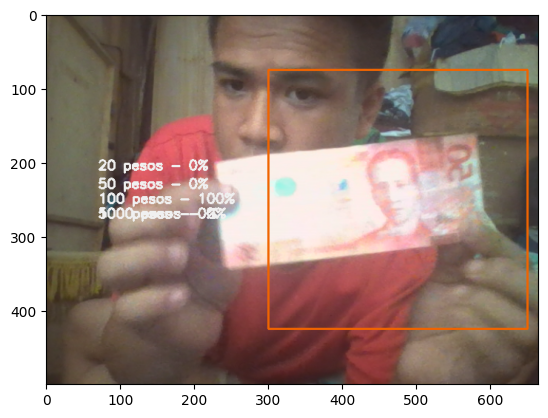

1/1 [==============================] - 0s 86ms/step


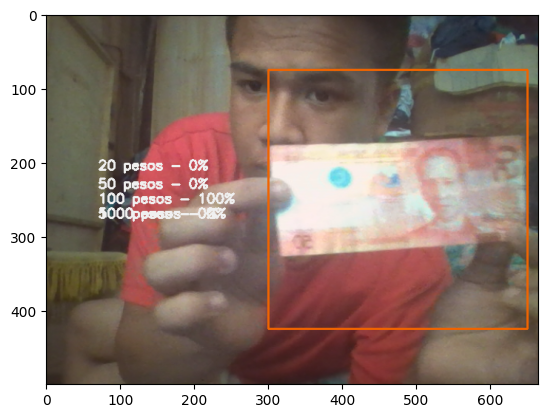

1/1 [==============================] - 0s 64ms/step


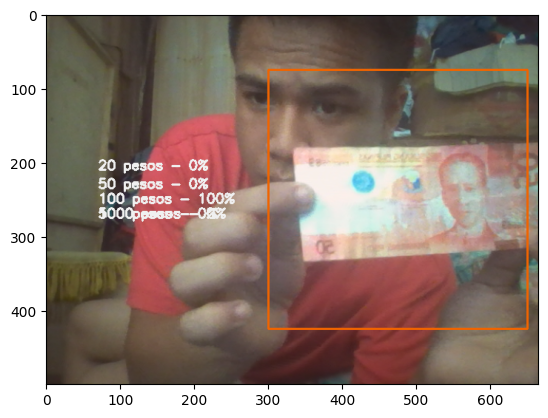

1/1 [==============================] - 0s 81ms/step


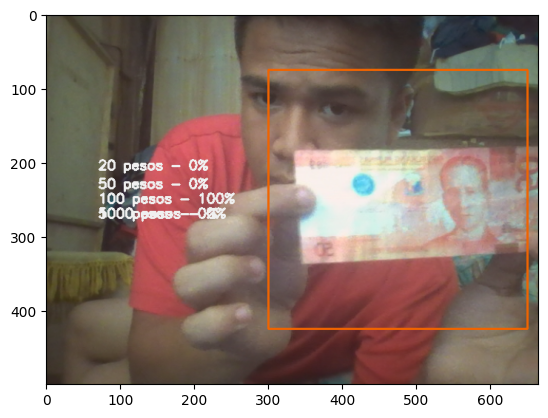

1/1 [==============================] - 0s 88ms/step


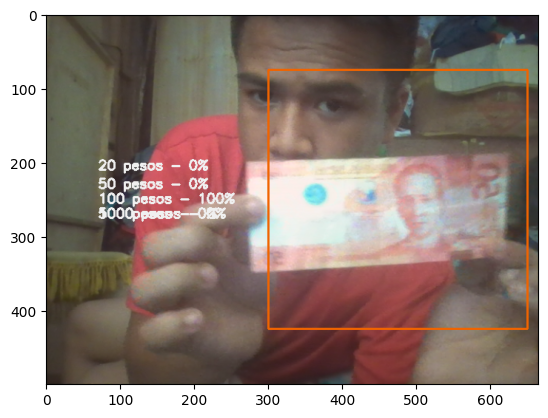

1/1 [==============================] - 0s 87ms/step


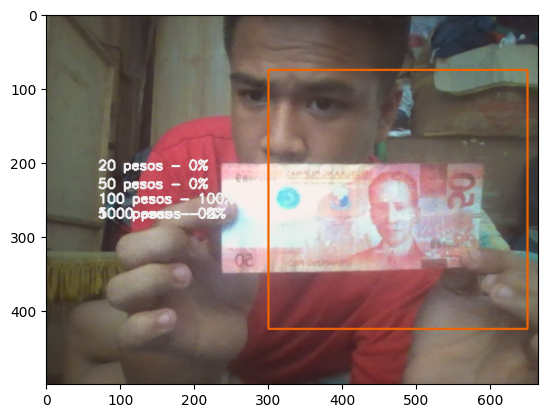

1/1 [==============================] - 0s 104ms/step


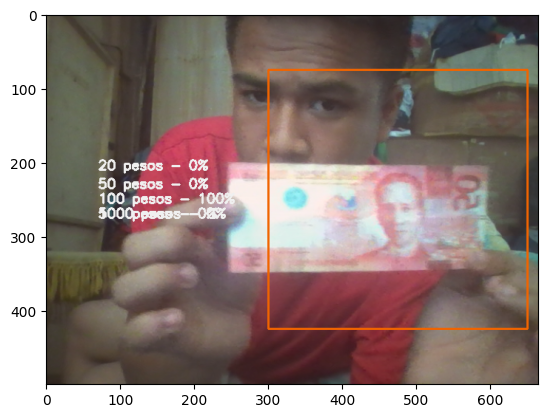

1/1 [==============================] - 0s 83ms/step


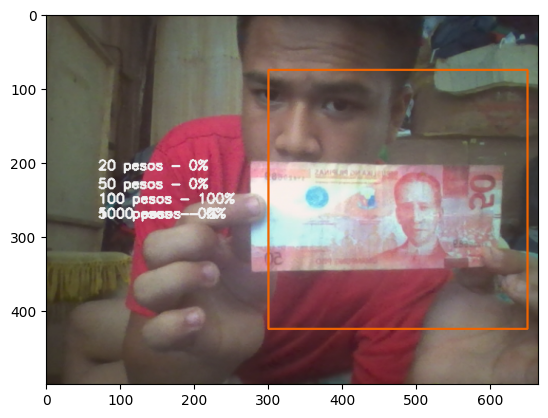

1/1 [==============================] - 0s 81ms/step


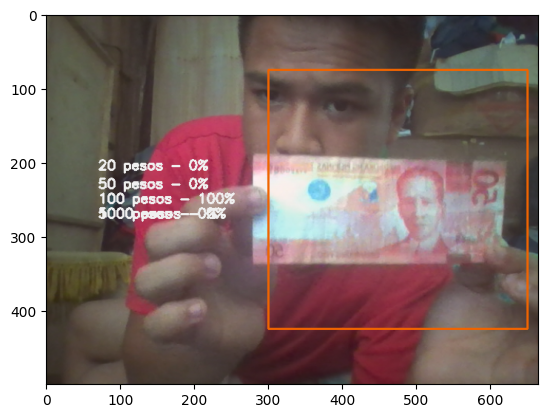

1/1 [==============================] - 0s 90ms/step


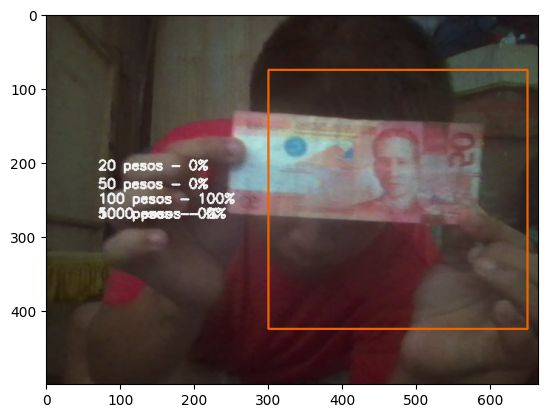

1/1 [==============================] - 0s 91ms/step


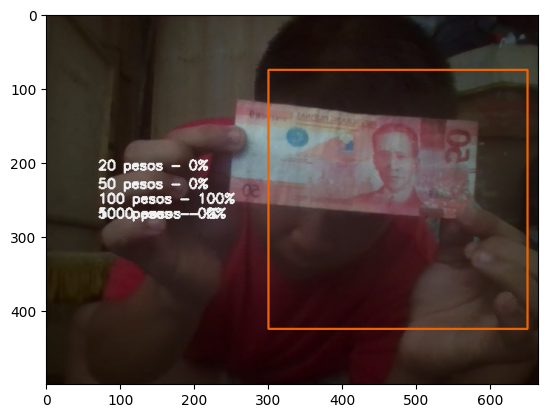

1/1 [==============================] - 0s 73ms/step


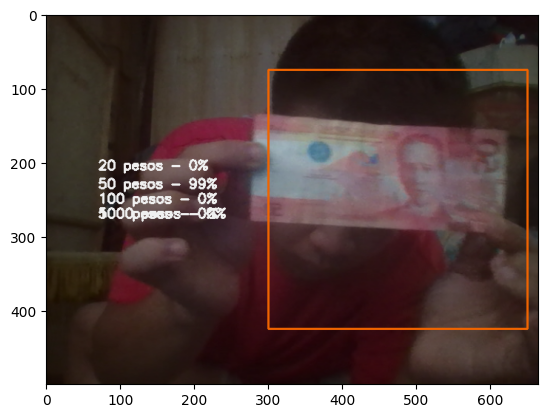

1/1 [==============================] - 0s 80ms/step


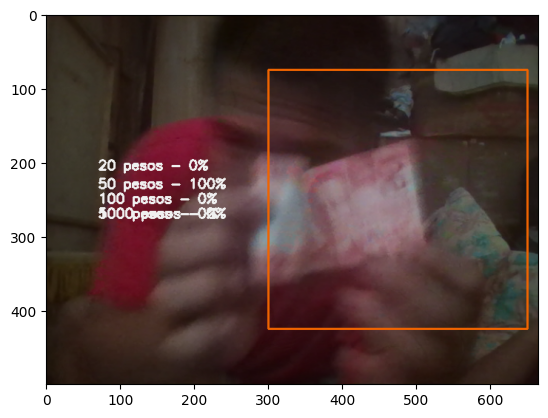

1/1 [==============================] - 0s 89ms/step


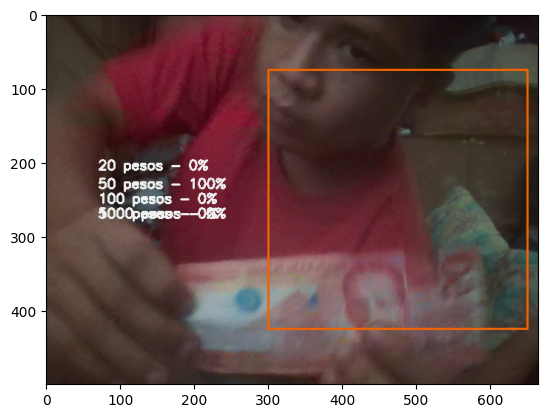

1/1 [==============================] - 0s 79ms/step


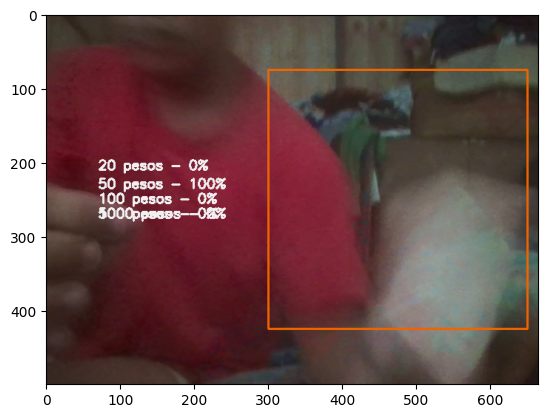

1/1 [==============================] - 0s 109ms/step


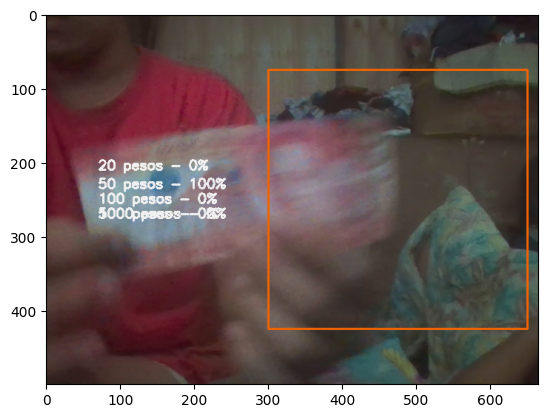

1/1 [==============================] - 0s 81ms/step


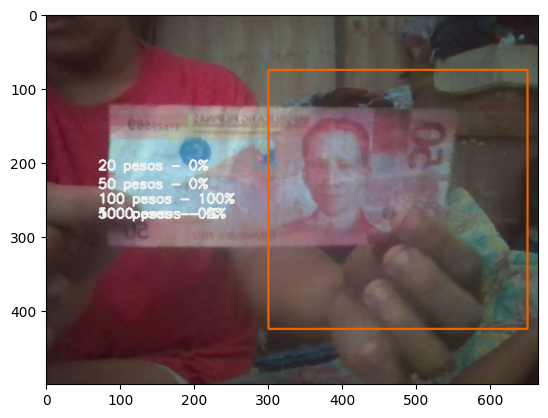

1/1 [==============================] - 0s 67ms/step


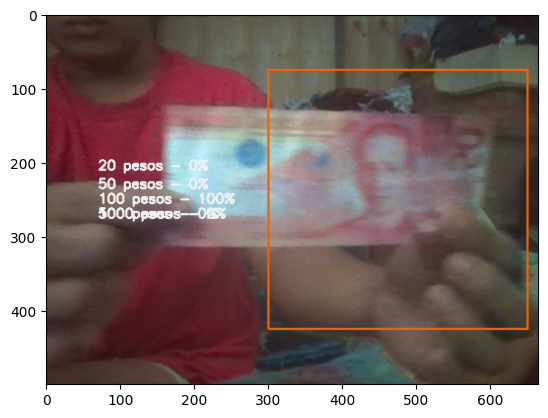

1/1 [==============================] - 0s 75ms/step


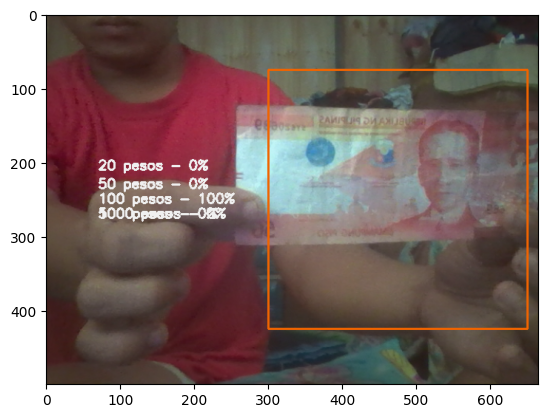

1/1 [==============================] - 0s 93ms/step


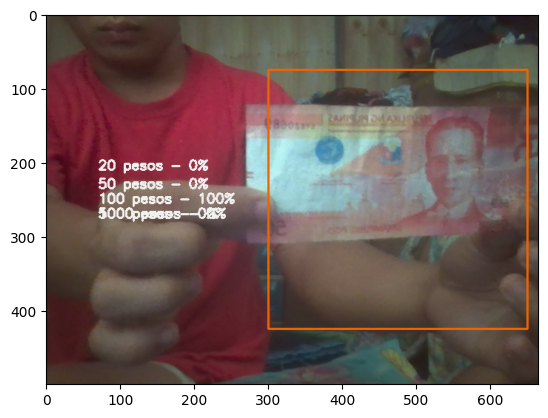

1/1 [==============================] - 0s 80ms/step


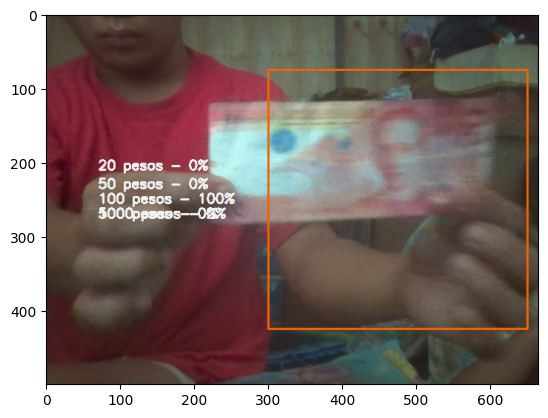

1/1 [==============================] - 0s 90ms/step


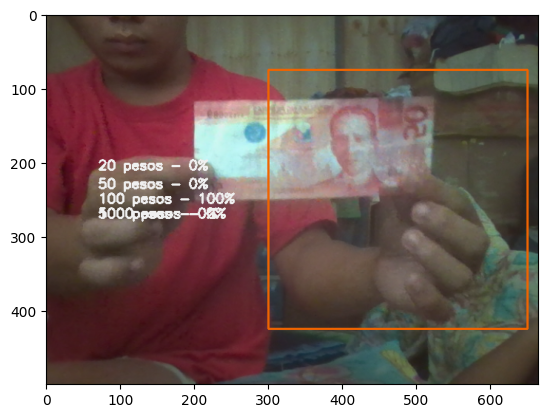

1/1 [==============================] - 0s 88ms/step


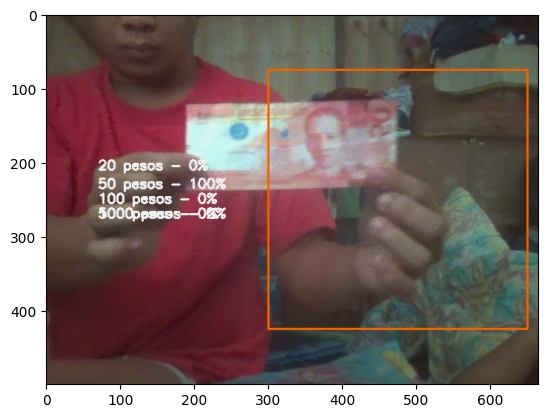

1/1 [==============================] - 0s 106ms/step


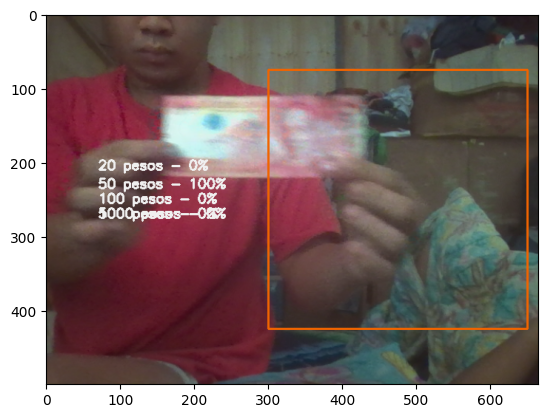

1/1 [==============================] - 0s 113ms/step


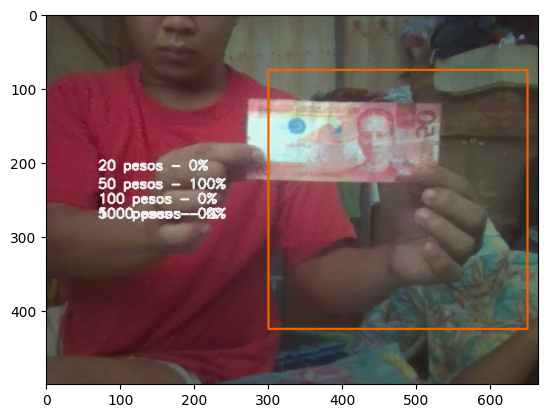

1/1 [==============================] - 0s 125ms/step


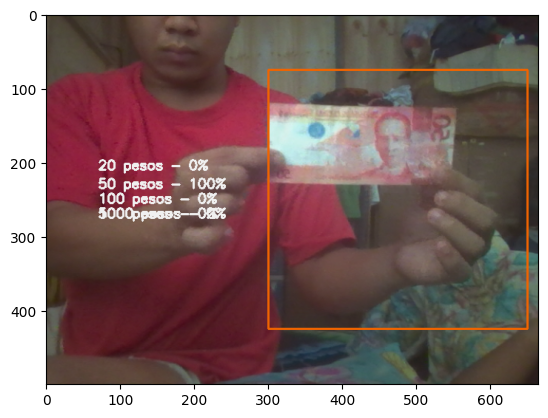

1/1 [==============================] - 0s 96ms/step


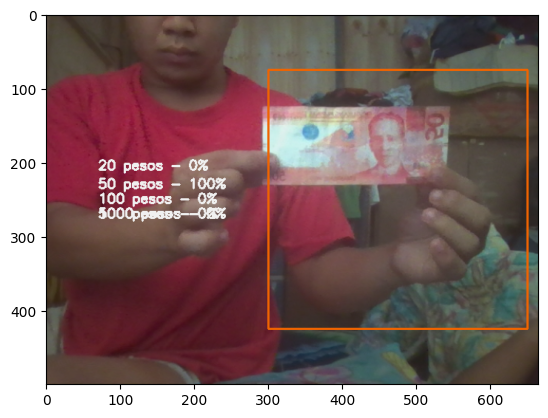

1/1 [==============================] - 0s 130ms/step


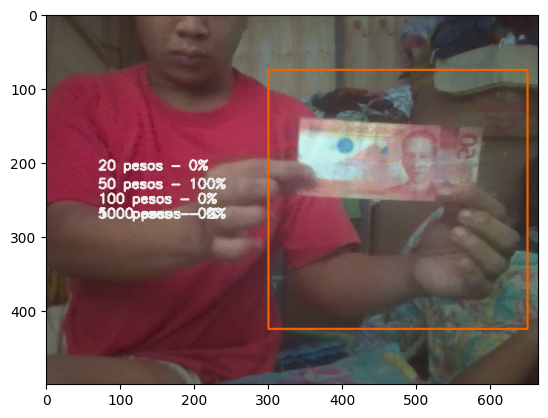

1/1 [==============================] - 0s 88ms/step


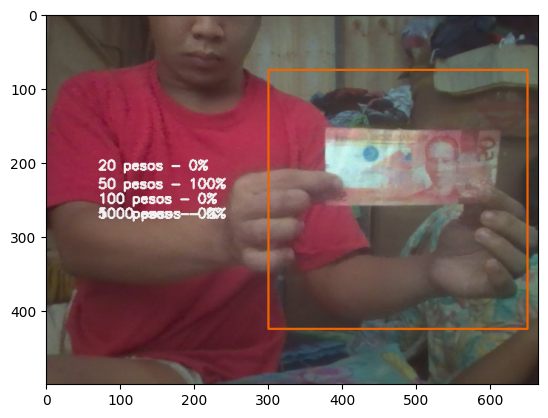

1/1 [==============================] - 0s 117ms/step


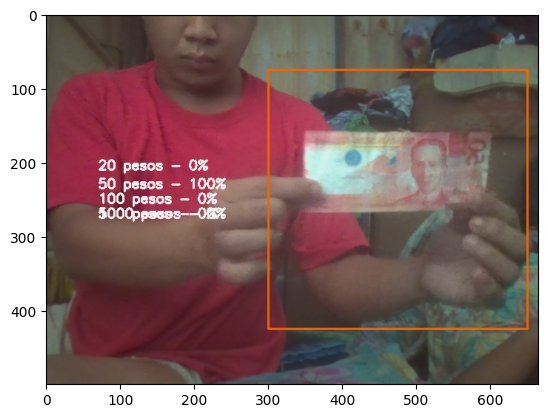

1/1 [==============================] - 0s 189ms/step


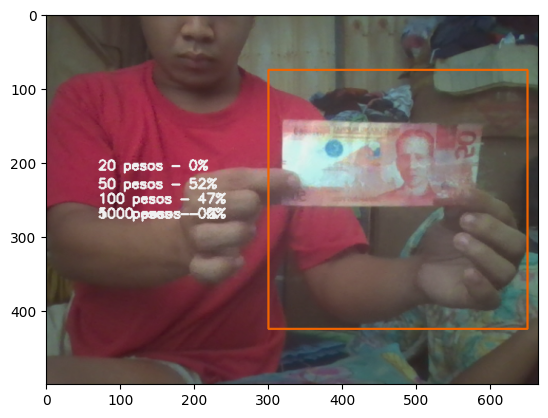

1/1 [==============================] - 0s 90ms/step


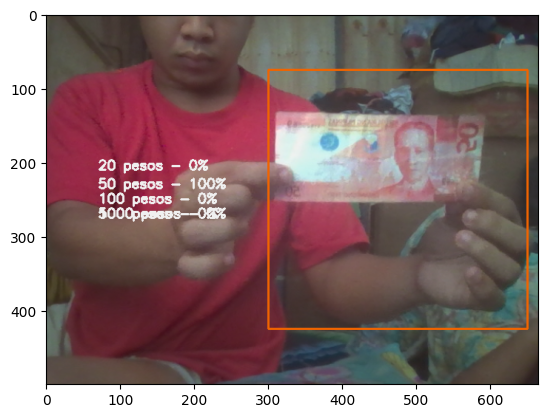

1/1 [==============================] - 0s 112ms/step


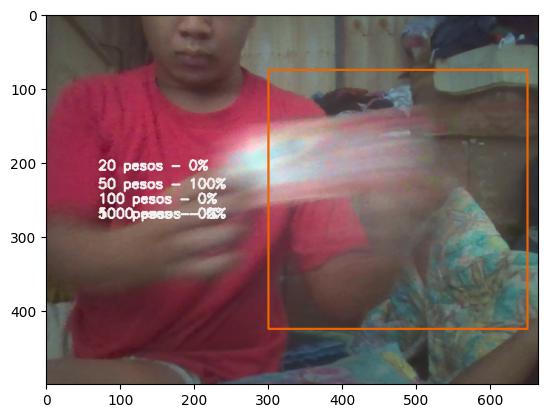

1/1 [==============================] - 0s 83ms/step


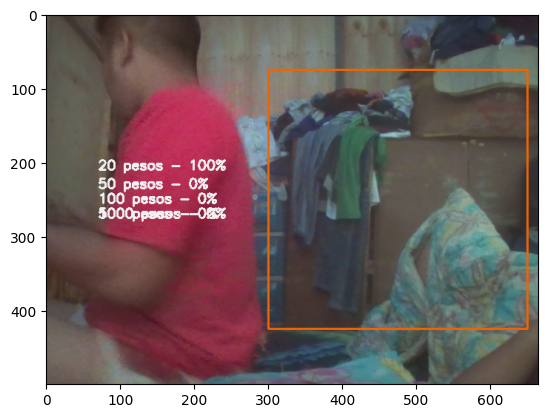

1/1 [==============================] - 0s 120ms/step


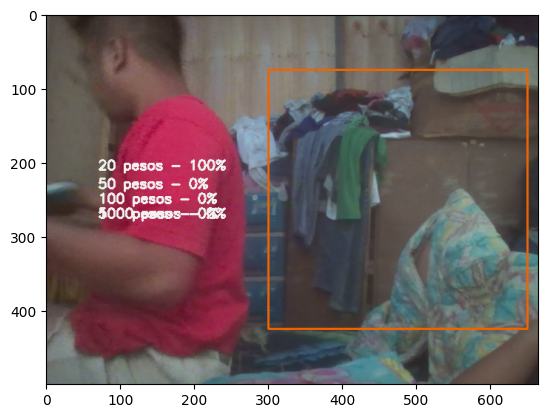

1/1 [==============================] - 0s 132ms/step


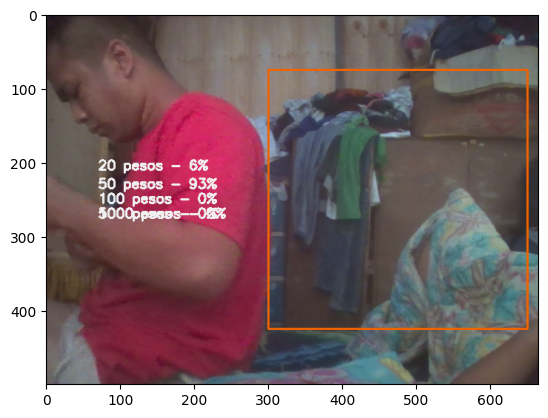

1/1 [==============================] - 0s 121ms/step


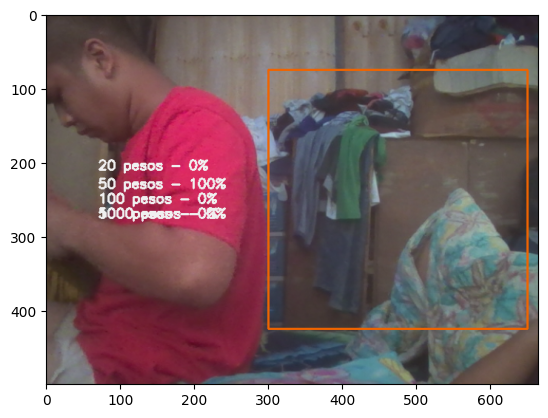

1/1 [==============================] - 0s 98ms/step


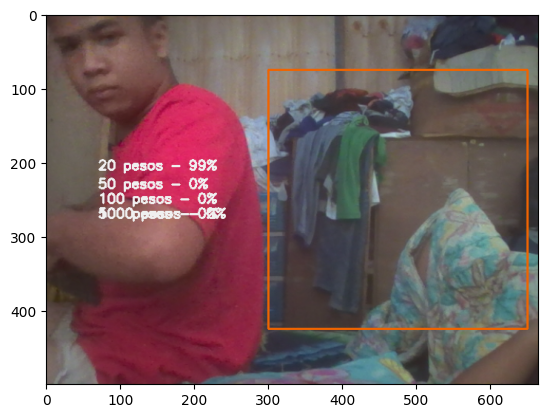

1/1 [==============================] - 0s 173ms/step


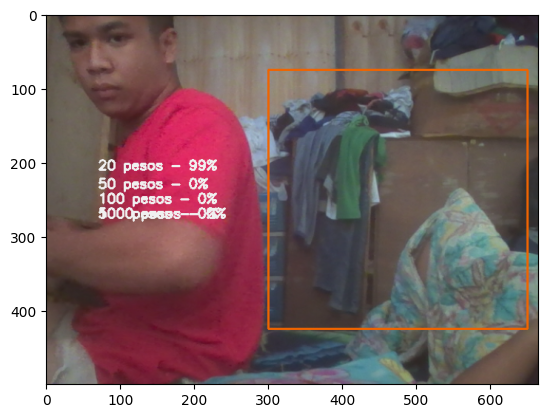

1/1 [==============================] - 0s 97ms/step


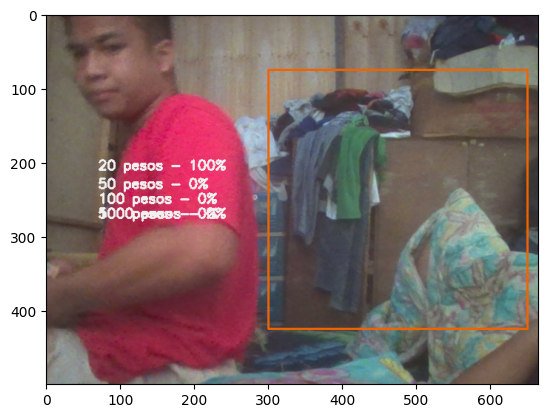

1/1 [==============================] - 0s 86ms/step


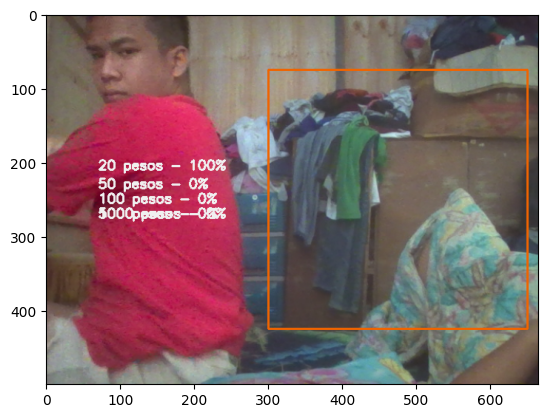

1/1 [==============================] - 0s 92ms/step


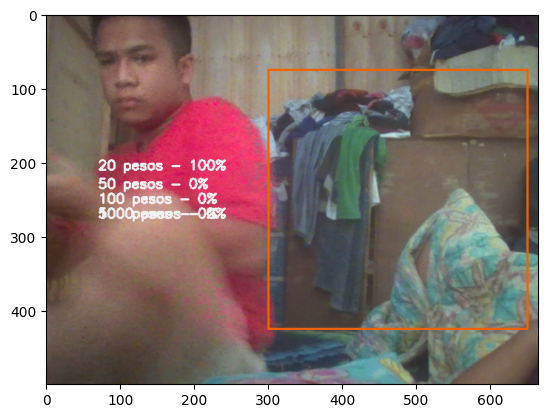

1/1 [==============================] - 0s 65ms/step


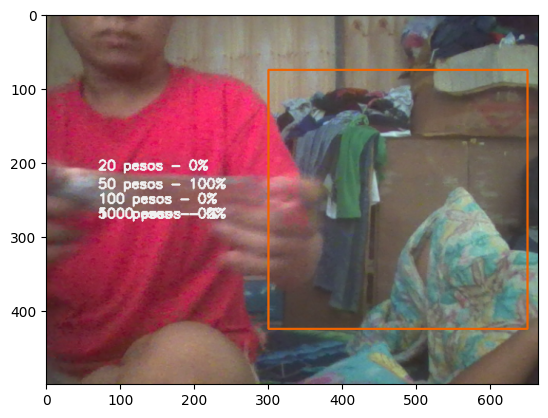

1/1 [==============================] - 0s 88ms/step


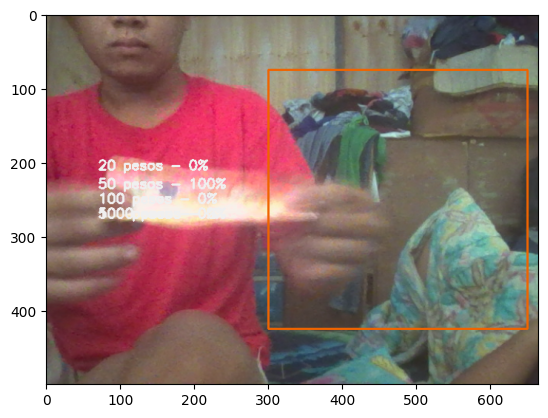

1/1 [==============================] - 0s 104ms/step


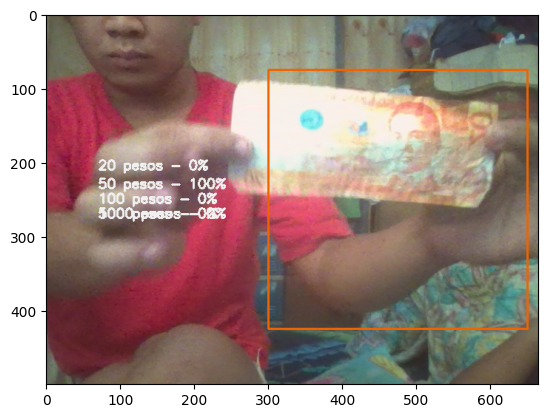

1/1 [==============================] - 0s 69ms/step


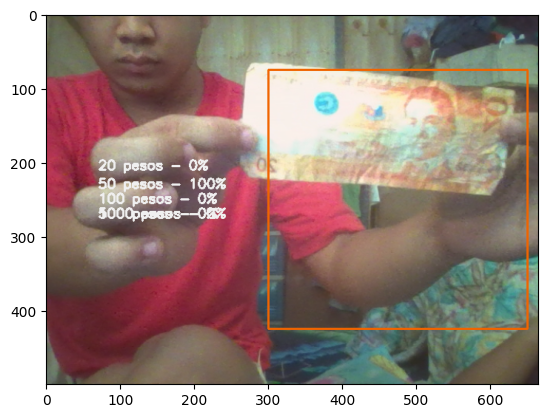

1/1 [==============================] - 0s 131ms/step


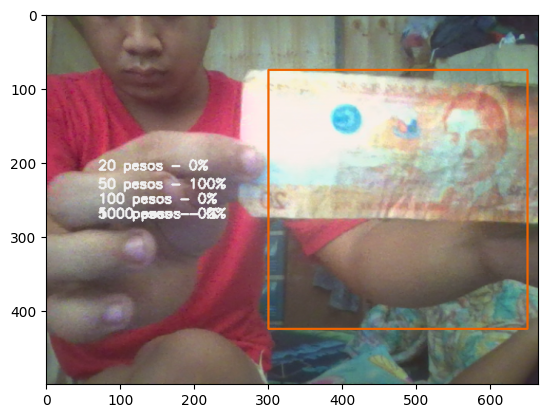

1/1 [==============================] - 0s 97ms/step


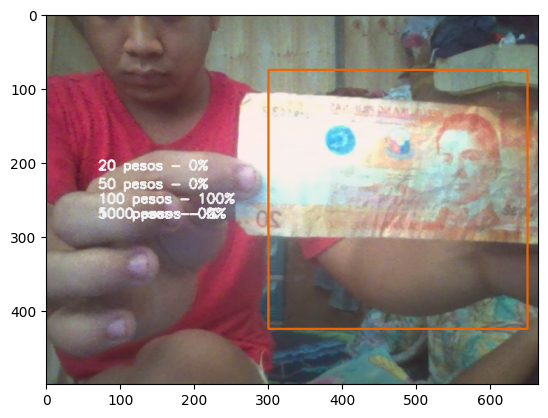

1/1 [==============================] - 0s 143ms/step


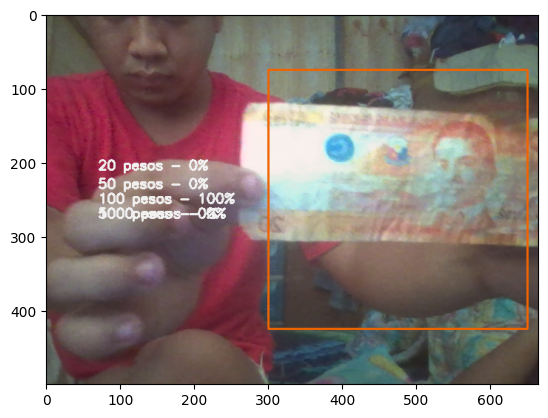

1/1 [==============================] - 0s 136ms/step


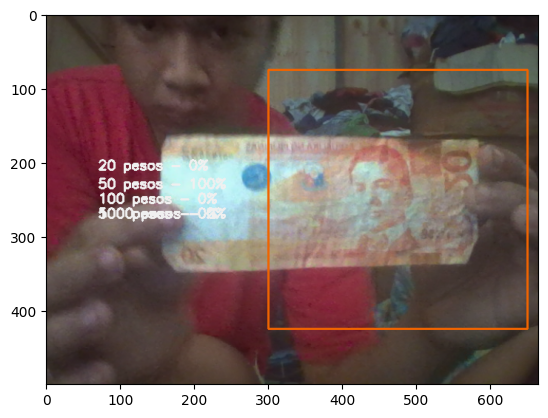

1/1 [==============================] - 0s 129ms/step


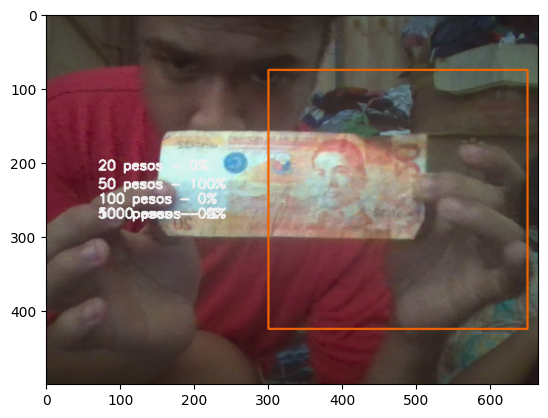

1/1 [==============================] - 0s 266ms/step


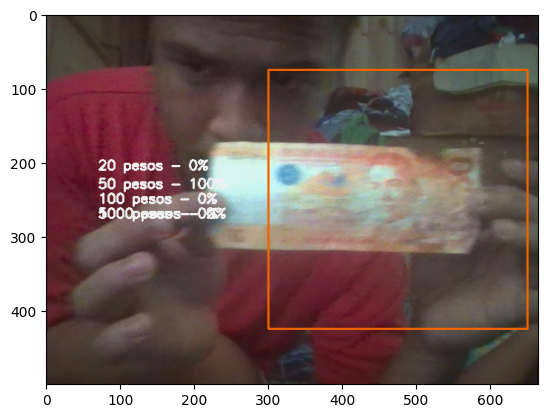

1/1 [==============================] - 0s 82ms/step


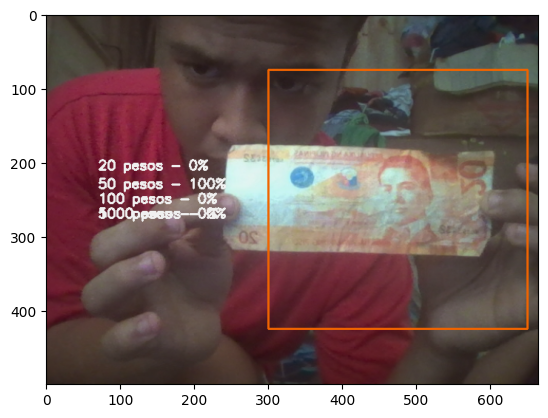

1/1 [==============================] - 0s 99ms/step


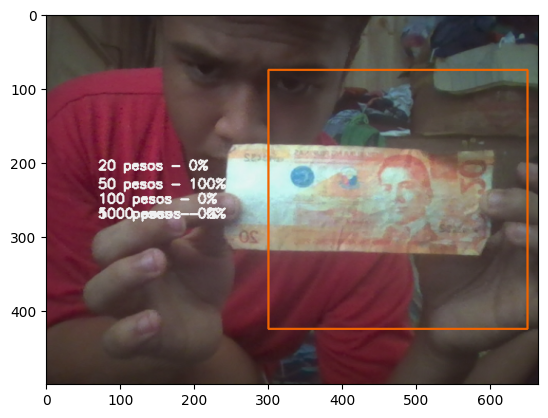

1/1 [==============================] - 0s 87ms/step


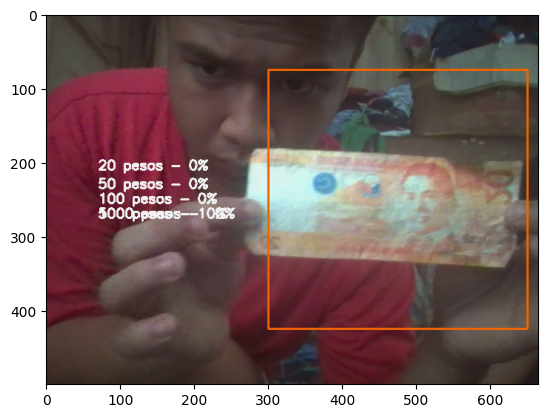

1/1 [==============================] - 0s 109ms/step


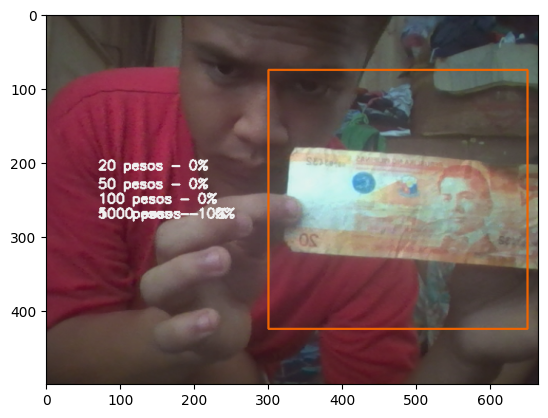

1/1 [==============================] - 0s 106ms/step


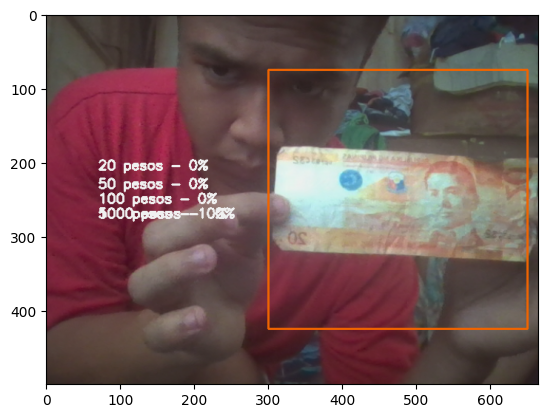

1/1 [==============================] - 0s 104ms/step


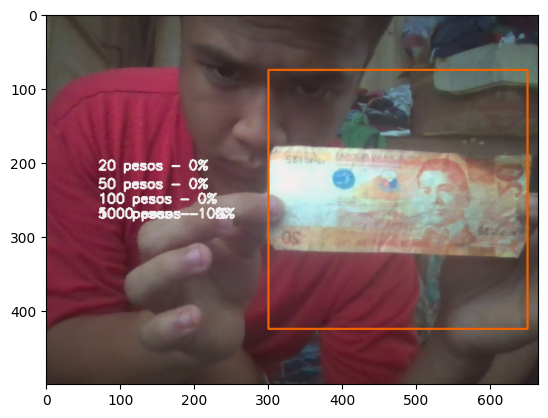

1/1 [==============================] - 0s 82ms/step


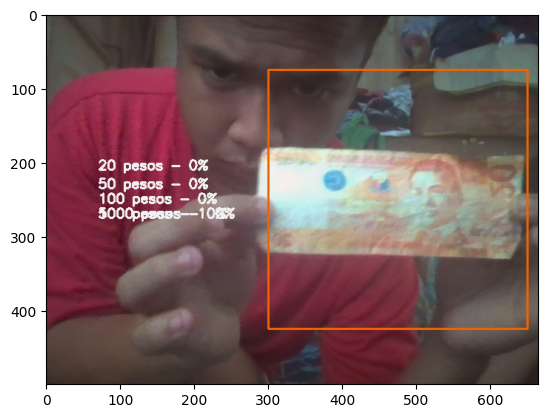

1/1 [==============================] - 0s 98ms/step


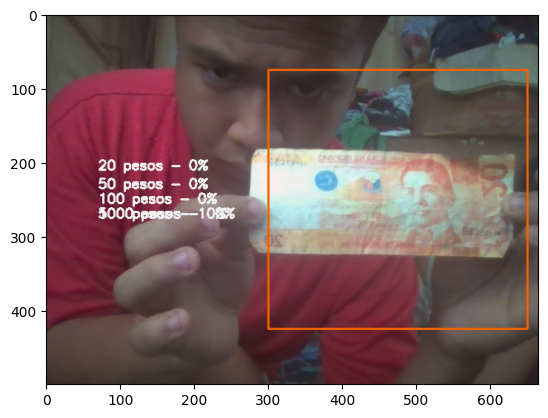

1/1 [==============================] - 0s 109ms/step


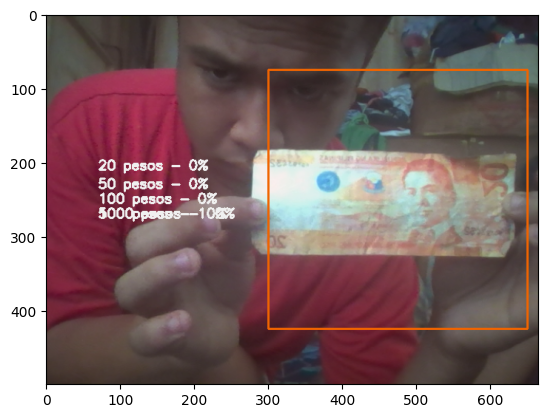

1/1 [==============================] - 0s 105ms/step


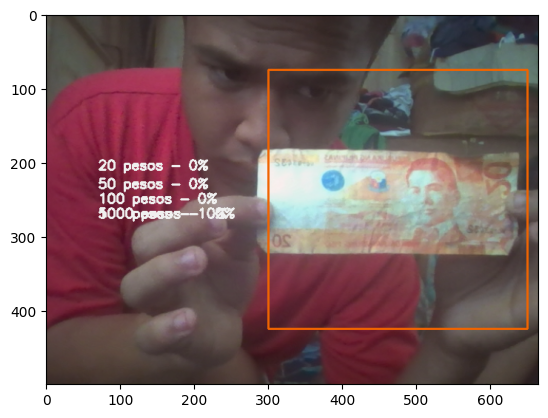

1/1 [==============================] - 0s 101ms/step


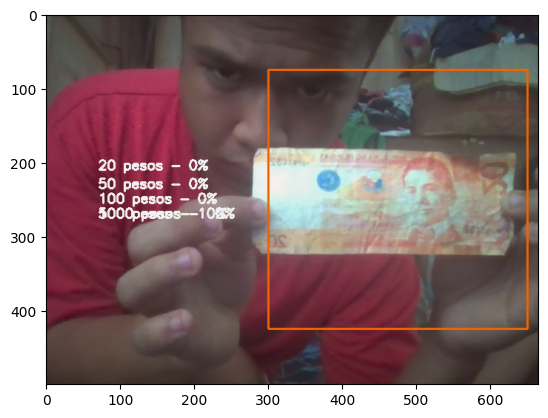

1/1 [==============================] - 0s 225ms/step


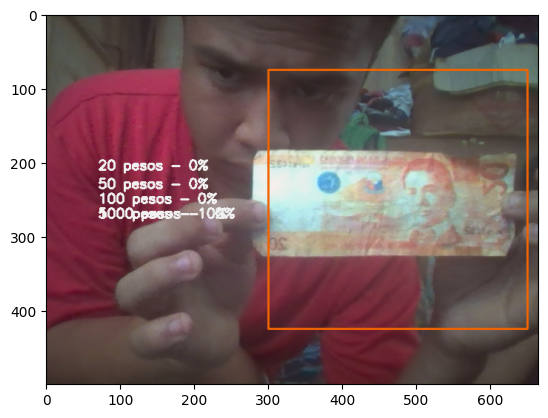

1/1 [==============================] - 0s 123ms/step


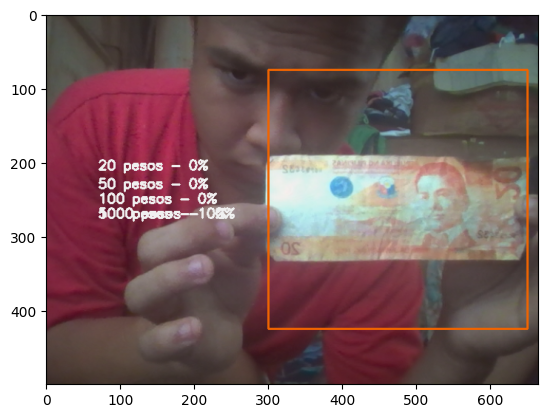

1/1 [==============================] - 0s 147ms/step


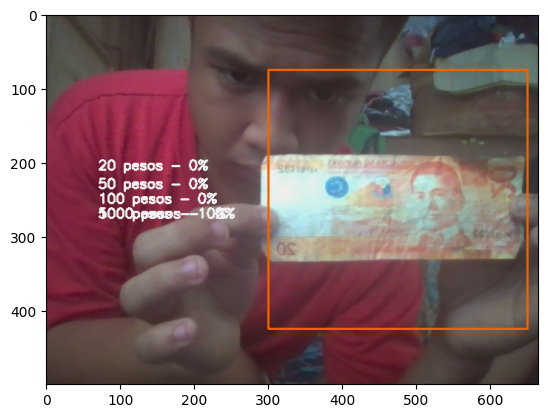

1/1 [==============================] - 0s 89ms/step


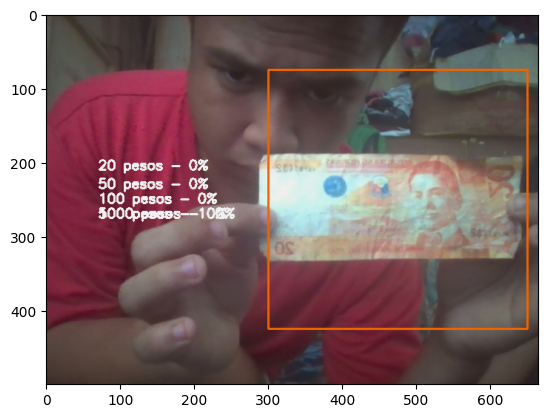

1/1 [==============================] - 0s 117ms/step


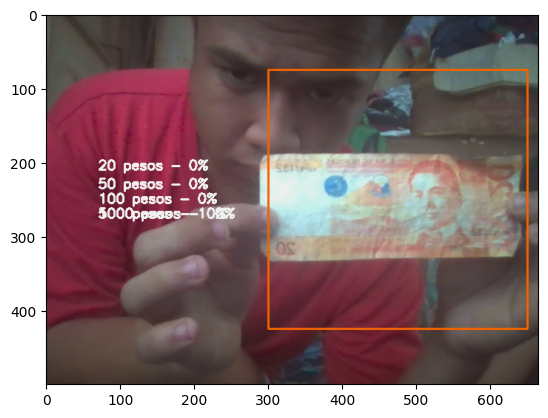

1/1 [==============================] - 0s 107ms/step


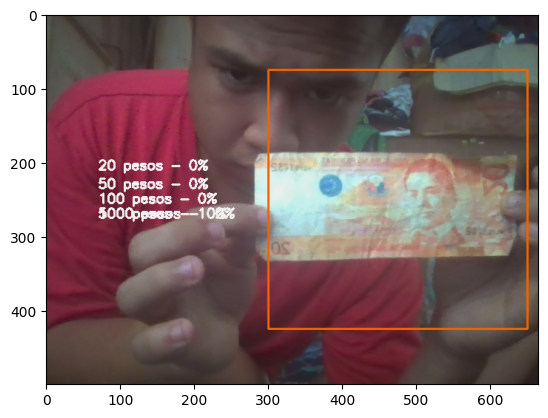

1/1 [==============================] - 0s 188ms/step


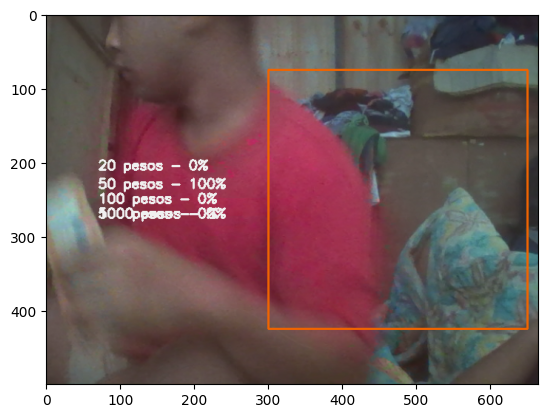

1/1 [==============================] - 0s 79ms/step


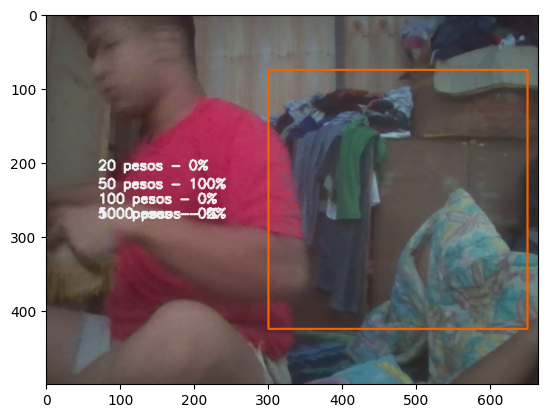

1/1 [==============================] - 0s 79ms/step


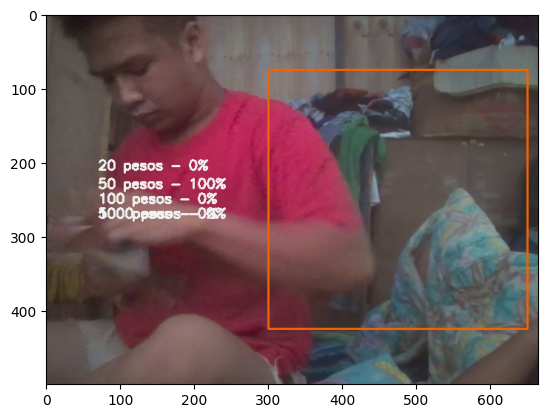

1/1 [==============================] - 0s 88ms/step


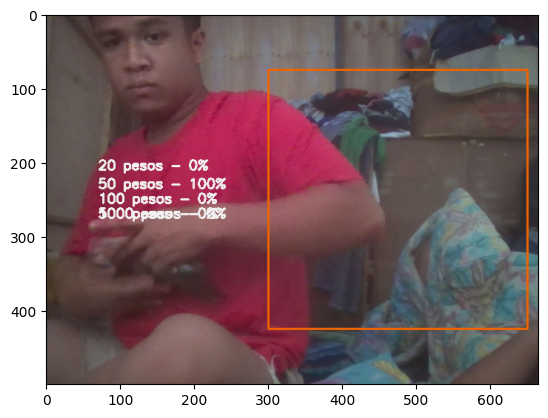

1/1 [==============================] - 0s 102ms/step


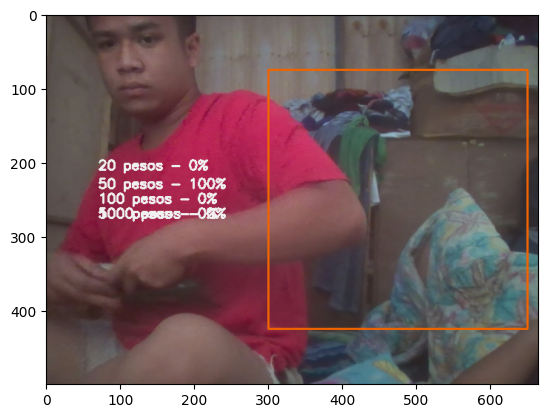

1/1 [==============================] - 0s 165ms/step


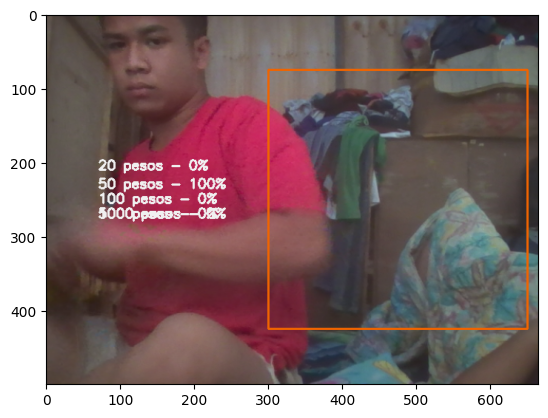

1/1 [==============================] - 0s 286ms/step


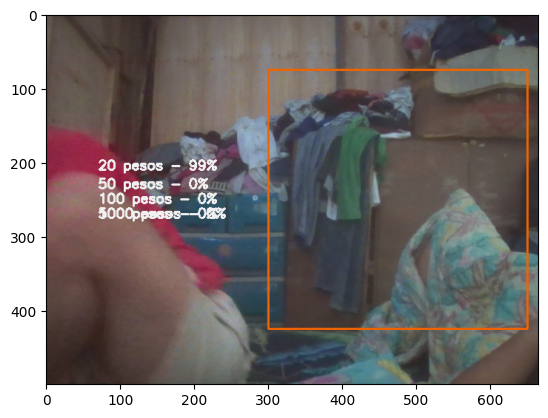

1/1 [==============================] - 0s 105ms/step


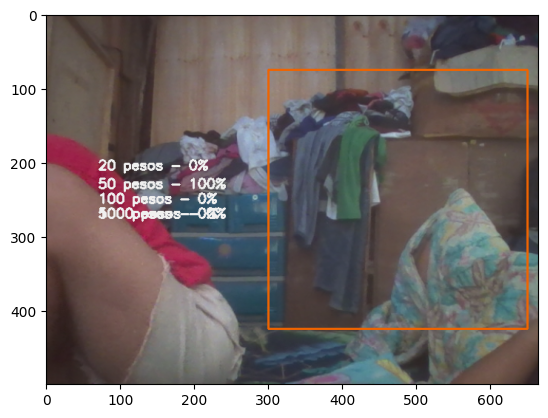

1/1 [==============================] - 0s 125ms/step


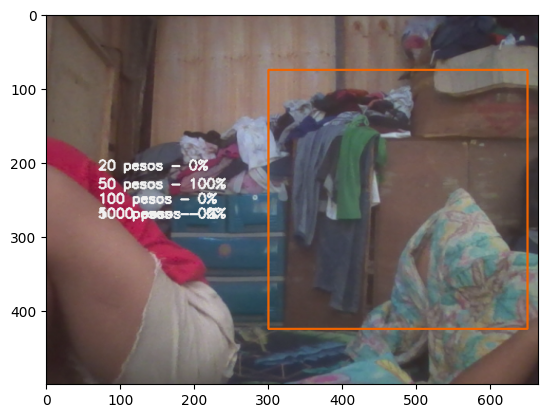

1/1 [==============================] - 0s 101ms/step


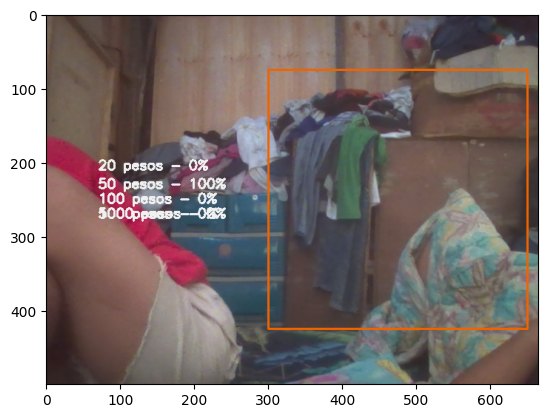

1/1 [==============================] - 0s 94ms/step


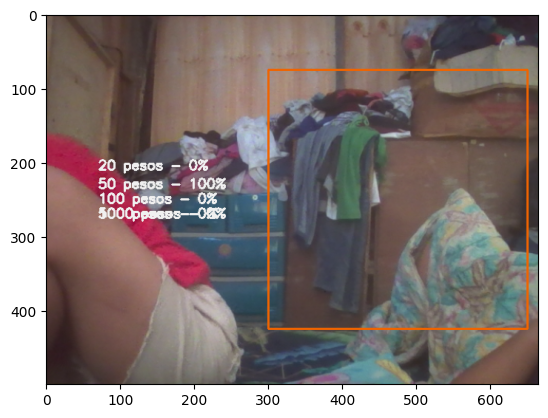

1/1 [==============================] - 0s 109ms/step


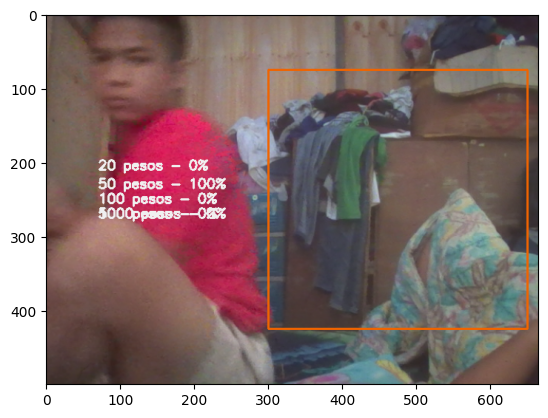

1/1 [==============================] - 0s 187ms/step


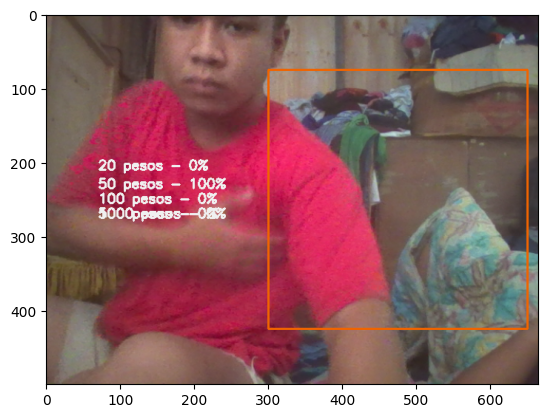

1/1 [==============================] - 0s 120ms/step


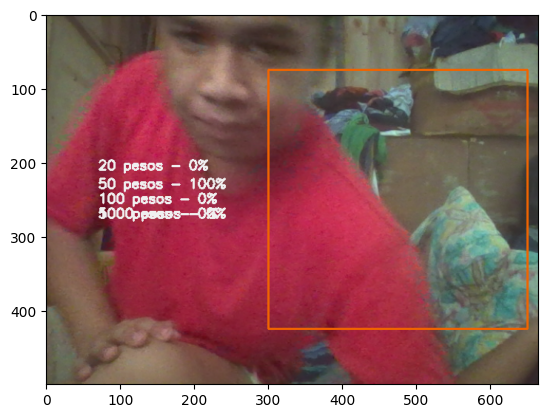

1/1 [==============================] - 0s 109ms/step


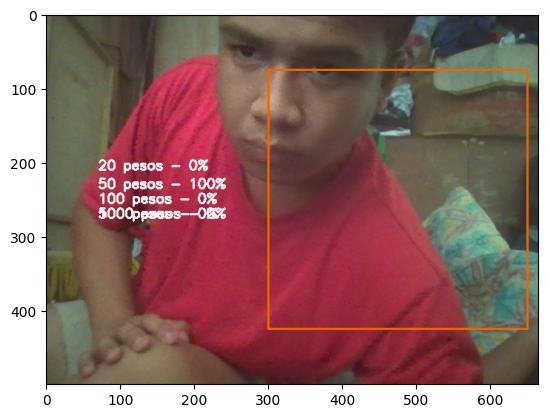

1/1 [==============================] - 0s 134ms/step


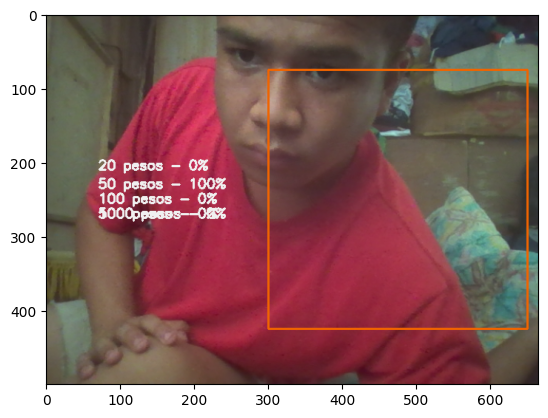

1/1 [==============================] - 0s 91ms/step


In [40]:
#live predicion using camera

from keras.applications import inception_v3

import time

CAMERA = cv2.VideoCapture(0)
camera_height  = 500

while (True):
    _, frame = CAMERA.read()

    #flip 
    frame = cv2.flip(frame, 1)

    #rescale the image output
    aspect = frame.shape[1] / float (frame.shape [0])
    res = int (aspect* camera_height)
    frame = cv2.resize(frame, (res, camera_height))

    #get roi
    roi = frame[75+2:425-2, 300+2:650-2]
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)

    #Adjust Alignment 
    roi = cv2.resize(roi, (width, height))
    roi_x = np.expand_dims(roi, axis = 0)

    predictions = model.predict(roi_x)

    type_1_x, type_2_x, type_3_x, type_4_x, type_5_x = predictions[0]
    # type_1_x, type_2_x, type_3_x, type_4_x = predictions

    #The green rectable 
    cv2.rectangle(frame, (300,75), (650,425), (240, 100, 0), 2)

    #Predictions/Labels
    tipe_1_txt ='{} - {}%'.format(class_names[0], int(type_1_x*100))
    cv2.putText(frame, tipe_1_txt, (70,210), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,240,240), 2)

    tipe_2_txt ='{} - {}%'.format(class_names[1], int(type_2_x*100))
    cv2.putText(frame, tipe_2_txt, (70,235), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,240,240), 2)

    tipe_3_txt ='{} - {}%'.format(class_names[2], int(type_3_x*100))
    cv2.putText(frame, tipe_3_txt, (70,255), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,240,240), 2)

    tipe_4_txt ='{} - {}%'.format(class_names[3], int(type_4_x*100))
    cv2.putText(frame, tipe_4_txt, (70,275), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,240,240), 2)

    tipe_5_txt ='{} - {}%'.format(class_names[4], int(type_5_x*100))
    cv2.putText(frame, tipe_5_txt, (70,275), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,240,240), 2)

    cv2.imshow("Real time object detection", cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

    #Controls q = quit/s = capturing 
    key = cv2.waitKey(1)

    if key & 0xff == ord('q'):
        break

    #preview
    # plt.imshow(frame)
    # plt.show()


In [41]:
#Camera
CAMERA.release()
cv2.destroyAllWindows()